In [1]:
# Imports:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Lasso, LassoCV
from sklearn.linear_model import ElasticNet, ElasticNetCV


%matplotlib inline

#display all output form a cell not just the last (the options are 'all', 'none', 'last' and 'last_expr'.)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


# seaborn plot styles

sns.set_style("dark")
sns.set_palette("deep")
plt.rcParams["axes.labelsize"] = 15
plt.rcParams["axes.titlesize"] = 20
myblue = '#0b5394'

source: [display all output from a jupyter cell](https://stackoverflow.com/questions/36786722/how-to-display-full-output-in-jupyter-not-only-last-result)

In [2]:
path_train = '../datasets/train.csv'
path_test = '../datasets/test.csv'

#read in training data

ames_df = pd.read_csv(path_train)

In [3]:
test = pd.read_csv(path_test)
test.shape

(878, 80)

# Exploratory Data Analysis

In [4]:
#Functions being used to featurize columns

def mean_encode_discrete_variable(discrete_variable, target, df):
    ''' returns a copy of the DataFrame df where the discrete_variable column 
    is replaced with a mean (target mean) encoded version of the column
    TODO: treat null values
    '''
    X = df.groupby([discrete_variable])[[target]].mean()
    new_df = df.copy()
    new_df[discrete_variable] = new_df[discrete_variable].map(lambda x : X.loc[x,target])
    return new_df

def create_bins_cts_variable(continuous_variable, df):
    '''
    divide continuous variable into deciles and 
    return a copy of df with an additional column 'continuous_variable_bins' 
    indicating the bin to which each row belongs
    '''
    df_copy = df.copy()
    df_copy[f'{continuous_variable}_bins'] = pd.qcut(df_copy[continuous_variable],10, duplicates = 'drop')
    return df_copy

def numerical_to_categorical_and_plot(category, target, df):
    '''
bins numerical columns into 10 bins with equal # observations and 
plots mean of target column for each bin vs bin average
TODO: 
include a plan to deal with missing values when binning the category column. 
add the average number of observations in each bin to the graphs
Didn't look up pd.qcut does with missing values

'''
    
    df_copy = df.copy()
    df_copy[f'{category}_bins'] = pd.qcut(df_copy[category],10, duplicates = 'drop')
    result_df = df_copy.groupby(f'{category}_bins').agg({target:['mean', 'count']})
    result_df[f'{category}_bin_average']=[round(a.mid) for a in result_df.index]
    result_df.columns = result_df.columns.to_flat_index()
    result_df.columns = [x[0]  if x[1] == '' else x[0]+'_'+x[1] for x in result_df.columns]
    fig, ax = plt.subplots()
    sns.lineplot(x = f'{category}_bin_average', y = f'{target}_mean' , data = result_df,         
                    ax = ax, color = '#0b5394');   
    return result_df


def plot_bar_line(category, target, df):
    
    
    '''
    creates the following two plots on a single figure with two y-axes 
    for category and target columns of a df
    1. left y-axis: bar graph mean of target per category
    2. right y-axes: line plot of # of observations in each value of category in df

    TODO: fix order of xticks for category '''
    
    fig, ax1 = plt.subplots()
    ax2 = ax1.twinx()
    
    

    df1 = (
        df.groupby([category])[target].mean()
        .to_frame().reset_index()
    )
    
    df2 =(df[category].value_counts(sort = False)
          .rename_axis(category).to_frame('Counts').reset_index()
    )
 
    
    
    df = df1.merge(df2, how ='left', on = category)
        
    df[category] = df[category].astype(str)

    sns.barplot(x = category, y = target, data = df, ci = False, 
                ax = ax1, color = '#0b5394')
    sns.lineplot(x = category , y = 'Counts', data = df, 
                 ax = ax2, color = 'red',marker = 'o'  );

    ax1.set_xlabel(category, color = 'black')
    ax1.set_ylabel(f'{target}_mean',color = '#0b5394')
    ax2.set_ylabel('# Observations',color = 'red');
    


In [5]:
ames_df.head()
ames_df.shape
ames_df.columns

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice
0,109,533352170,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,544,531379050,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,153,535304180,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,318,916386060,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,255,906425045,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500


(2051, 81)

Index(['Id', 'PID', 'MS SubClass', 'MS Zoning', 'Lot Frontage', 'Lot Area',
       'Street', 'Alley', 'Lot Shape', 'Land Contour', 'Utilities',
       'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1',
       'Condition 2', 'Bldg Type', 'House Style', 'Overall Qual',
       'Overall Cond', 'Year Built', 'Year Remod/Add', 'Roof Style',
       'Roof Matl', 'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type',
       'Mas Vnr Area', 'Exter Qual', 'Exter Cond', 'Foundation', 'Bsmt Qual',
       'Bsmt Cond', 'Bsmt Exposure', 'BsmtFin Type 1', 'BsmtFin SF 1',
       'BsmtFin Type 2', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF',
       'Heating', 'Heating QC', 'Central Air', 'Electrical', '1st Flr SF',
       '2nd Flr SF', 'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Full Bath',
       'Bsmt Half Bath', 'Full Bath', 'Half Bath', 'Bedroom AbvGr',
       'Kitchen AbvGr', 'Kitchen Qual', 'TotRms AbvGrd', 'Functional',
       'Fireplaces', 'Fireplace Qu', 'Garage Type', 'Garage Yr Blt',
       'G

**Selecting features for a first model**

In [6]:
corrs = ames_df.corr()[['SalePrice']]
corrs.sort_values(by = 'SalePrice', ascending = False)

corrs.shape

,SalePrice
SalePrice,1.000000
Overall Qual,0.800207
Gr Liv Area,0.697038
Garage Area,0.650270
Garage Cars,0.648220
Total Bsmt SF,0.628925
1st Flr SF,0.618486
Year Built,0.571849
Year Remod/Add,0.550370
Full Bath,0.537969


(39, 1)

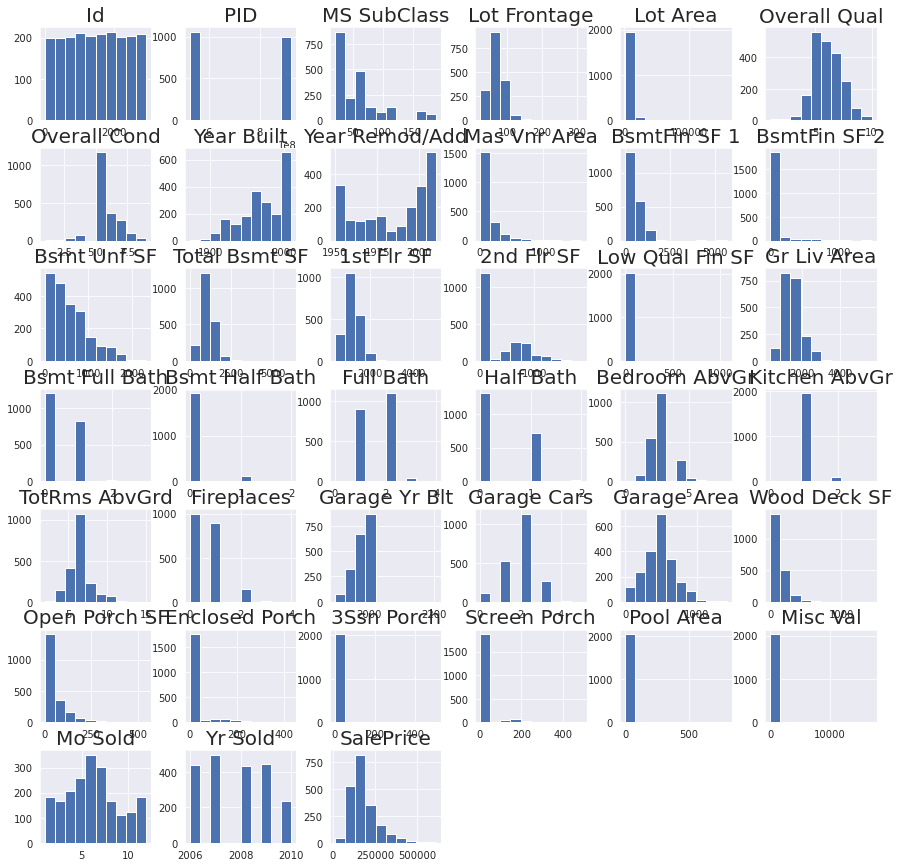

In [7]:
ames_df.hist(figsize = (15, 15));

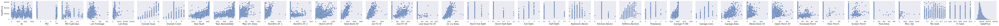

In [8]:

sns.pairplot(
    data = ames_df, x_vars = [col for col in ames_df.select_dtypes(np.number).columns], y_vars = ['SalePrice']
    
)

In [9]:
ames_cat = ames_df.select_dtypes(object)

[col for col in ames_df.select_dtypes(np.number).columns][5:]

['Overall Qual',
 'Overall Cond',
 'Year Built',
 'Year Remod/Add',
 'Mas Vnr Area',
 'BsmtFin SF 1',
 'BsmtFin SF 2',
 'Bsmt Unf SF',
 'Total Bsmt SF',
 '1st Flr SF',
 '2nd Flr SF',
 'Low Qual Fin SF',
 'Gr Liv Area',
 'Bsmt Full Bath',
 'Bsmt Half Bath',
 'Full Bath',
 'Half Bath',
 'Bedroom AbvGr',
 'Kitchen AbvGr',
 'TotRms AbvGrd',
 'Fireplaces',
 'Garage Yr Blt',
 'Garage Cars',
 'Garage Area',
 'Wood Deck SF',
 'Open Porch SF',
 'Enclosed Porch',
 '3Ssn Porch',
 'Screen Porch',
 'Pool Area',
 'Misc Val',
 'Mo Sold',
 'Yr Sold',
 'SalePrice']

In [11]:
# make a list of columns with any null values
null_counts = ames_df.isnull().sum()
columns_with_nulls = null_counts[null_counts>0].index
columns_with_nulls
null_counts[null_counts>0]


#'Garage Area' and 'Garage Cars' have high correlation (>0.6) with 'SalePrice' and have only one missing value. 
#Replacing the missing value in 'Garage Area' and 'Garage Cars' with 0
for col in ['Garage Area', 'Garage Cars']:
    ames_df.loc[ames_df[col].isna(),col] = 0 


#dropping the rest of the columns with null values for now
null_counts = ames_df.isnull().sum()
columns_with_nulls = null_counts[null_counts>0].index

df = ames_df.drop(columns = columns_with_nulls)
df
assert(df.shape[1] + columns_with_nulls.shape[0]   == ames_df.shape[1])
df.shape

Index(['Lot Frontage', 'Alley', 'Mas Vnr Type', 'Mas Vnr Area', 'Bsmt Qual',
       'Bsmt Cond', 'Bsmt Exposure', 'BsmtFin Type 1', 'BsmtFin SF 1',
       'BsmtFin Type 2', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF',
       'Bsmt Full Bath', 'Bsmt Half Bath', 'Fireplace Qu', 'Garage Type',
       'Garage Yr Blt', 'Garage Finish', 'Garage Cars', 'Garage Area',
       'Garage Qual', 'Garage Cond', 'Pool QC', 'Fence', 'Misc Feature'],
      dtype='object')

Lot Frontage       330
Alley             1911
Mas Vnr Type        22
Mas Vnr Area        22
Bsmt Qual           55
Bsmt Cond           55
Bsmt Exposure       58
BsmtFin Type 1      55
BsmtFin SF 1         1
BsmtFin Type 2      56
BsmtFin SF 2         1
Bsmt Unf SF          1
Total Bsmt SF        1
Bsmt Full Bath       2
Bsmt Half Bath       2
Fireplace Qu      1000
Garage Type        113
Garage Yr Blt      114
Garage Finish      114
Garage Cars          1
Garage Area          1
Garage Qual        114
Garage Cond        114
Pool QC           2042
Fence             1651
Misc Feature      1986
dtype: int64

,Id,PID,MS SubClass,MS Zoning,Lot Area,Street,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Exter Qual,Exter Cond,Foundation,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Garage Cars,Garage Area,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice
0,109,533352170,60,RL,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,Gd,TA,CBlock,GasA,Ex,Y,SBrkr,725,754,0,1479,2,1,3,1,Gd,6,Typ,0,2.0,475.0,Y,0,44,0,0,0,0,0,3,2010,WD,130500
1,544,531379050,60,RL,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,Gd,TA,PConc,GasA,Ex,Y,SBrkr,913,1209,0,2122,2,1,4,1,Gd,8,Typ,1,2.0,559.0,Y,0,74,0,0,0,0,0,4,2009,WD,220000
2,153,535304180,20,RL,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,TA,Gd,CBlock,GasA,TA,Y,SBrkr,1057,0,0,1057,1,0,3,1,Gd,5,Typ,0,1.0,246.0,Y,0,52,0,0,0,0,0,1,2010,WD,109000
3,318,916386060,60,RL,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,TA,TA,PConc,GasA,Gd,Y,SBrkr,744,700,0,1444,2,1,3,1,TA,7,Typ,0,2.0,400.0,Y,100,0,0,0,0,0,0,4,2010,WD,174000
4,255,906425045,50,RL,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,TA,TA,PConc,GasA,TA,Y,SBrkr,831,614,0,1445,2,0,3,1,TA,6,Typ,0,2.0,484.0,N,0,59,0,0,0,0,0,3,2010,WD,138500
5,138,535126040,20,RL,16492,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,Norm,1Fam,1Story,6,6,1966,2002,Gable,CompShg,BrkFace,Plywood,Gd,TA,CBlock,GasA,Ex,Y,SBrkr,1888,0,0,1888,2,1,2,1,Gd,6,Mod,1,2.0,578.0,Y,0,0,0,0,0,0,0,6,2010,WD,190000
6,2827,908186070,180,RM,3675,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,TA,TA,PConc,GasA,Gd,Y,SBrkr,1072,0,0,1072,2,0,2,1,TA,5,Typ,0,2.0,525.0,Y,0,44,0,0,0,0,0,6,2006,New,140000
7,145,535154050,20,RL,12160,Pave,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,TA,TA,CBlock,GasA,Fa,Y,SBrkr,1188,0,0,1188,1,0,3,1,TA,6,Typ,0,2.0,531.0,Y,0,0,0,0,0,0,0,5,2010,COD,142000
8,1942,535353130,20,RL,15783,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1Story,5,5,1952,1952,Gable,CompShg,Wd Sdng,Wd Sdng,TA,TA,CBlock,GasA,TA,Y,SBrkr,924,0,0,924,1,0,2,1,TA,6,Typ,0,1.0,420.0,Y,0,324,0,0,0,0,400,6,2007,WD,112500
9,1956,535426130,60,RL,11606,Pave,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,Norm,1Fam,2Story,5,5,1969,1969,Gable,CompShg,Plywood,Plywood,TA,TA,PConc,GasA,TA,Y,SBrkr,1040,1040,0,2080,1,2,5,1,Fa,9,Typ,2,2.0,504.0,Y,335,0,0,0,0,0,0,9,2007,WD,135000


(2051, 57)

In [12]:
corrs = df.corr()[['SalePrice']]
corrs.sort_values(by = 'SalePrice', ascending = False)

,SalePrice
SalePrice,1.000000
Overall Qual,0.800207
Gr Liv Area,0.697038
Garage Area,0.649897
Garage Cars,0.647781
1st Flr SF,0.618486
Year Built,0.571849
Year Remod/Add,0.550370
Full Bath,0.537969
TotRms AbvGrd,0.504014


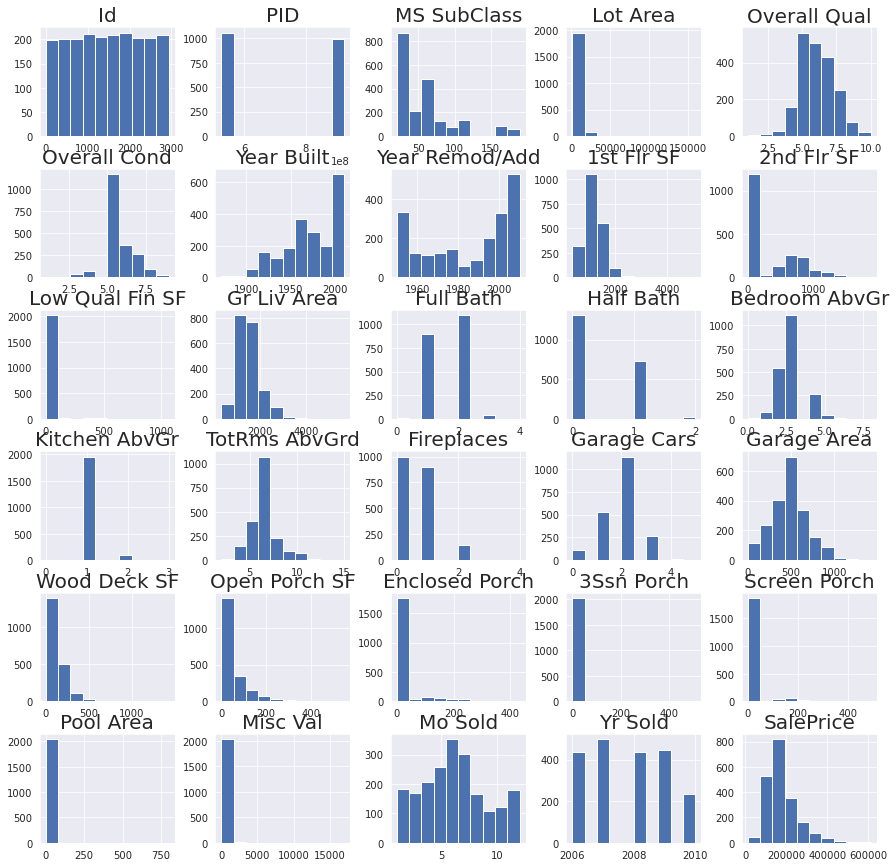

In [13]:
df.hist(figsize = (15, 15));

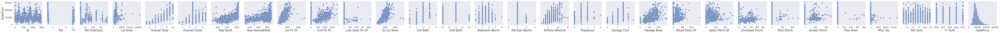

In [14]:

sns.pairplot(
    data = df, x_vars = [col for col in df.select_dtypes(np.number).columns], y_vars = ['SalePrice']
    
);

# Numerical Columns
**Investigating 'Overall Cond' and 'Overall Qual'**

- Prices increase with 'Overall Qual' as expected
- There is negative correlation with 'Overall Cond' which is counterintuitive
- Not including 'Overall Cond' in the model
- 'Overall Qual' is featurized by mean encoding for every quality level

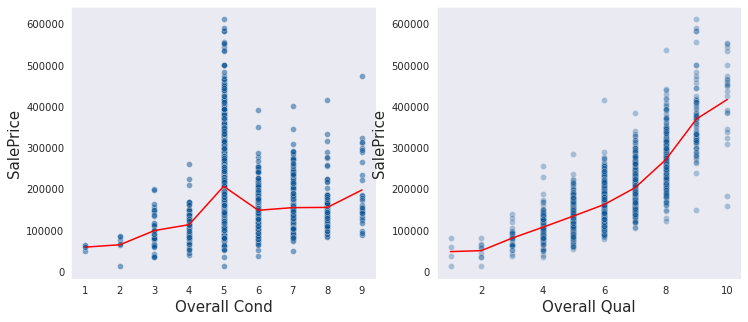

In [15]:
fig, ax = plt.subplots(1,2, figsize = (12,5));
sns.scatterplot(x = 'Overall Cond', y = 'SalePrice', data = df, ax = ax[0], color = myblue, alpha = 0.5);
sns.scatterplot(x = 'Overall Qual', y = 'SalePrice', data = df, ax = ax[1], color = myblue, alpha = 0.3);
sns.lineplot(x = 'Overall Qual', y = 'SalePrice', data = df.groupby('Overall Qual').mean(), 
             ax = ax[1], color = 'red');
sns.lineplot(x = 'Overall Cond', y = 'SalePrice', data = df.groupby('Overall Cond').mean(), 
             ax = ax[0], color = 'red');

**Garage Area and Garage Cars**

- As they are highly correlated to each other (corr = 0.89) and to SalePrice, using
only 'Garage Area' as a feature in the model

count    2051.000000
mean      473.440761
std       216.135102
min         0.000000
25%       319.000000
50%       480.000000
75%       576.000000
max      1418.000000
Name: Garage Area, dtype: float64

count    2051.000000
mean        1.775719
std         0.765357
min         0.000000
25%         1.000000
50%         2.000000
75%         2.000000
max         5.000000
Name: Garage Cars, dtype: float64

,Garage Area,Garage Cars,SalePrice
Garage Area,1.000000,0.893442,0.649897
Garage Cars,0.893442,1.000000,0.647781
SalePrice,0.649897,0.647781,1.000000


count    2051.000000
mean      473.440761
std       216.135102
min         0.000000
25%       319.000000
50%       480.000000
75%       576.000000
max      1418.000000
Name: Garage Area, dtype: float64

SalePrice      
                           mean count
Garage Area_bins                     
(-0.001, 240.0]   115911.711864   236
(240.0, 294.0]    123945.715084   179
(294.0, 384.0]    132218.788732   213
(384.0, 440.0]    164881.342742   248
(440.0, 480.0]    176207.544944   178
(480.0, 516.0]    184602.822222   180
(516.0, 564.0]    197041.094340   212
(564.0, 621.0]    191494.974490   196
(621.0, 760.0]    239993.514706   204
(760.0, 1418.0]   296301.858537   205

,SalePrice_mean,SalePrice_count,Garage Area_bin_average
Garage Area_bins,,,
"(-0.001, 240.0]",115911.711864,236,120
"(240.0, 294.0]",123945.715084,179,267
"(294.0, 384.0]",132218.788732,213,339
"(384.0, 440.0]",164881.342742,248,412
"(440.0, 480.0]",176207.544944,178,460
"(480.0, 516.0]",184602.822222,180,498
"(516.0, 564.0]",197041.094340,212,540
"(564.0, 621.0]",191494.974490,196,592
"(621.0, 760.0]",239993.514706,204,690


SalePrice      
                      mean count
Garage Cars                     
0.0          106065.991228   114
1.0          126824.591603   524
2.0          184125.956866  1136
3.0          309382.745247   263
4.0          229653.846154    13
5.0          126500.000000     1

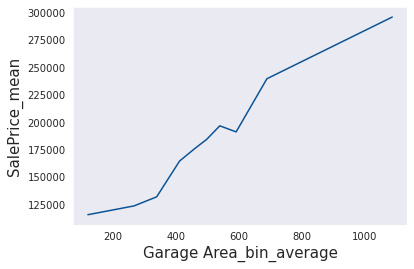

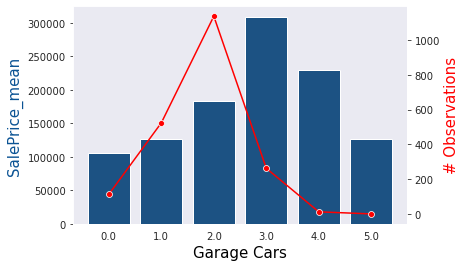

In [16]:
df['Garage Area'].describe()
df['Garage Cars'].describe()
df[['Garage Area','Garage Cars', 'SalePrice']].corr()
target = 'SalePrice'
for continuous_variable in ['Garage Area']:
    df[continuous_variable].describe()
    df_copy = df.copy()
    df_copy[f'{continuous_variable}_bins'] = pd.qcut(df_copy[continuous_variable],10, duplicates = 'drop')
    df_copy.groupby(f'{continuous_variable}_bins').agg({target:['mean', 'count']})   
    numerical_to_categorical_and_plot(continuous_variable, target, df_copy)
    
plot_bar_line('Garage Cars', 'SalePrice', df_copy)
df.groupby(['Garage Cars'])[['SalePrice']].agg(['mean','count'])


**Investigating Gr Liv Area, 1st Flr SF and 2nd Flr SF**

- They are highly correlated to each other (corr = 0.56). 
- Using only GR Liv Area as-is in the model which has a slightly higher correaltion (0.70 vs 0.62) with SalePrice



,Gr Liv Area,1st Flr SF,2nd Flr SF,SalePrice
Gr Liv Area,1.000000,0.562441,0.639092,0.697038
1st Flr SF,0.562441,1.000000,-0.268855,0.618486
2nd Flr SF,0.639092,-0.268855,1.000000,0.248452
SalePrice,0.697038,0.618486,0.248452,1.000000


count    2051.000000
mean     1499.330083
std       500.447829
min       334.000000
25%      1129.000000
50%      1444.000000
75%      1728.500000
max      5642.000000
Name: Gr Liv Area, dtype: float64

SalePrice      
                           mean count
Gr Liv Area_bins                     
(333.999, 935.0]  106475.285024   207
(935.0, 1073.0]   125953.180488   205
(1073.0, 1200.0]  135269.701422   211
(1200.0, 1332.0]  154001.277778   198
(1332.0, 1444.0]  164760.936585   205
(1444.0, 1560.0]  180328.559809   209
(1560.0, 1669.0]  195643.825871   201
(1669.0, 1824.0]  216104.251208   207
(1824.0, 2142.0]  236251.758621   203
(2142.0, 5642.0]  301549.536585   205

,SalePrice_mean,SalePrice_count,Gr Liv Area_bin_average
Gr Liv Area_bins,,,
"(333.999, 935.0]",106475.285024,207,634
"(935.0, 1073.0]",125953.180488,205,1004
"(1073.0, 1200.0]",135269.701422,211,1136
"(1200.0, 1332.0]",154001.277778,198,1266
"(1332.0, 1444.0]",164760.936585,205,1388
"(1444.0, 1560.0]",180328.559809,209,1502
"(1560.0, 1669.0]",195643.825871,201,1614
"(1669.0, 1824.0]",216104.251208,207,1746
"(1824.0, 2142.0]",236251.758621,203,1983


count    2051.000000
mean     1164.488055
std       396.446923
min       334.000000
25%       879.500000
50%      1093.000000
75%      1405.000000
max      5095.000000
Name: 1st Flr SF, dtype: float64

SalePrice      
                           mean count
1st Flr SF_bins                      
(333.999, 745.0]  120059.791262   206
(745.0, 848.0]    146497.793269   208
(848.0, 916.0]    144676.392157   204
(916.0, 1005.0]   151090.161765   204
(1005.0, 1093.0]  155830.359223   206
(1093.0, 1196.0]  173312.715686   204
(1196.0, 1329.0]  185436.024390   205
(1329.0, 1489.0]  205283.024510   204
(1489.0, 1670.0]  230575.587379   206
(1670.0, 5095.0]  302973.441176   204

,SalePrice_mean,SalePrice_count,1st Flr SF_bin_average
1st Flr SF_bins,,,
"(333.999, 745.0]",120059.791262,206,539
"(745.0, 848.0]",146497.793269,208,796
"(848.0, 916.0]",144676.392157,204,882
"(916.0, 1005.0]",151090.161765,204,960
"(1005.0, 1093.0]",155830.359223,206,1049
"(1093.0, 1196.0]",173312.715686,204,1144
"(1196.0, 1329.0]",185436.024390,205,1262
"(1329.0, 1489.0]",205283.024510,204,1409
"(1489.0, 1670.0]",230575.587379,206,1580


count    2051.000000
mean      329.329108
std       425.671046
min         0.000000
25%         0.000000
50%         0.000000
75%       692.500000
max      1862.000000
Name: 2nd Flr SF, dtype: float64

SalePrice      
                          mean count
2nd Flr SF_bins                     
(-0.001, 396.0]  174095.786353  1231
(396.0, 623.0]   139833.682927   205
(623.0, 756.0]   165008.650718   209
(756.0, 916.0]   203370.129353   201
(916.0, 1862.0]  262694.321951   205

,SalePrice_mean,SalePrice_count,2nd Flr SF_bin_average
2nd Flr SF_bins,,,
"(-0.001, 396.0]",174095.786353,1231,198
"(396.0, 623.0]",139833.682927,205,510
"(623.0, 756.0]",165008.650718,209,690
"(756.0, 916.0]",203370.129353,201,836
"(916.0, 1862.0]",262694.321951,205,1389


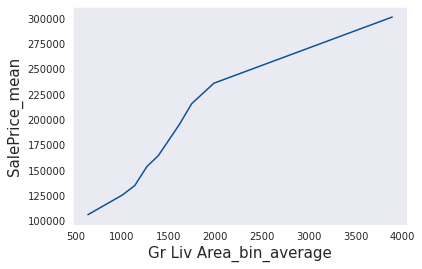

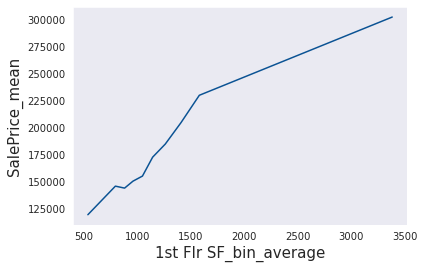

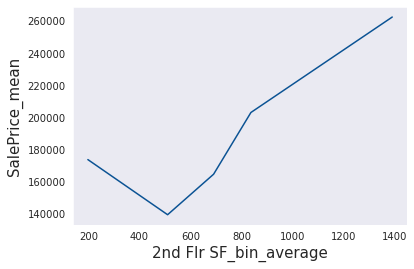

In [17]:
df[['Gr Liv Area', '1st Flr SF', '2nd Flr SF', 'SalePrice']].corr()

target = 'SalePrice'

for continuous_variable in ['Gr Liv Area', '1st Flr SF', '2nd Flr SF']:
    df[continuous_variable].describe()
    df_copy = df.copy()
    df_copy[f'{continuous_variable}_bins'] = pd.qcut(df_copy[continuous_variable],10, duplicates = 'drop')
    df_copy.groupby(f'{continuous_variable}_bins').agg({target:['mean', 'count']})   
    numerical_to_categorical_and_plot(continuous_variable, target, df_copy)

**Investigating 'Year Built' and  'Year Remod/Add'**

- 'Year Built' and  'Year Remod/Add' are both highly correlated to 'Sale Price'
-  Not a very linear relationship
-  A higher order term may be helpful


,Year Built,Year Remod/Add,SalePrice
Year Built,1.000000,0.629116,0.571849
Year Remod/Add,0.629116,1.000000,0.550370
SalePrice,0.571849,0.550370,1.000000


,Year Built,Year Remod/Add,SalePrice
count,2051.000000,2051.000000,2051.000000
mean,1971.708922,1984.190151,181469.701609
std,30.177889,21.036250,79258.659352
min,1872.000000,1950.000000,12789.000000
25%,1953.500000,1964.500000,129825.000000
50%,1974.000000,1993.000000,162500.000000
75%,2001.000000,2004.000000,214000.000000
max,2010.000000,2010.000000,611657.000000


Index(['Id', 'PID', 'MS SubClass', 'MS Zoning', 'Lot Area', 'Street',
       'Lot Shape', 'Land Contour', 'Utilities', 'Lot Config', 'Land Slope',
       'Neighborhood', 'Condition 1', 'Condition 2', 'Bldg Type',
       'House Style', 'Overall Qual', 'Overall Cond', 'Year Built',
       'Year Remod/Add', 'Roof Style', 'Roof Matl', 'Exterior 1st',
       'Exterior 2nd', 'Exter Qual', 'Exter Cond', 'Foundation', 'Heating',
       'Heating QC', 'Central Air', 'Electrical', '1st Flr SF', '2nd Flr SF',
       'Low Qual Fin SF', 'Gr Liv Area', 'Full Bath', 'Half Bath',
       'Bedroom AbvGr', 'Kitchen AbvGr', 'Kitchen Qual', 'TotRms AbvGrd',
       'Functional', 'Fireplaces', 'Garage Cars', 'Garage Area', 'Paved Drive',
       'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch',
       'Screen Porch', 'Pool Area', 'Misc Val', 'Mo Sold', 'Yr Sold',
       'Sale Type', 'SalePrice', 'Year Built_bins', 'Year Remod/Add_bins'],
      dtype='object')

,SalePrice
Year Built_bins,
"(1871.999, 1925.0]",123630.451613
"(1925.0, 1948.0]",132371.206573
"(1948.0, 1957.0]",133220.037634
"(1957.0, 1965.0]",149693.585714
"(1965.0, 1974.0]",146716.152709
"(1974.0, 1987.0]",172621.550725
"(1987.0, 1998.0]",221554.699074
"(1998.0, 2003.0]",228665.065990
"(2003.0, 2006.0]",242764.490842


,SalePrice
Year Remod/Add_bins,
"(1949.999, 1959.0]",120795.997619
"(1959.0, 1969.0]",144697.785714
"(1969.0, 1978.0]",146530.957547
"(1978.0, 1993.0]",184350.275701
"(1993.0, 1998.0]",201327.363184
"(1998.0, 2002.0]",205984.454545
"(2002.0, 2005.0]",207636.653386
"(2005.0, 2007.0]",239454.011450
"(2007.0, 2010.0]",281540.104651


,SalePrice_mean,SalePrice_count,Year Built_bin_average
Year Built_bins,,,
"(1871.999, 1925.0]",123630.451613,217,1898
"(1925.0, 1948.0]",132371.206573,213,1936
"(1948.0, 1957.0]",133220.037634,186,1952
"(1957.0, 1965.0]",149693.585714,210,1961
"(1965.0, 1974.0]",146716.152709,203,1970
"(1974.0, 1987.0]",172621.550725,207,1980
"(1987.0, 1998.0]",221554.699074,216,1992
"(1998.0, 2003.0]",228665.065990,197,2000
"(2003.0, 2006.0]",242764.490842,273,2004


,SalePrice_mean,SalePrice_count,Year Remod/Add_bin_average
Year Remod/Add_bins,,,
"(1949.999, 1959.0]",120795.997619,420,1954
"(1959.0, 1969.0]",144697.785714,196,1964
"(1969.0, 1978.0]",146530.957547,212,1974
"(1978.0, 1993.0]",184350.275701,214,1986
"(1993.0, 1998.0]",201327.363184,201,1996
"(1998.0, 2002.0]",205984.454545,209,2000
"(2002.0, 2005.0]",207636.653386,251,2004
"(2005.0, 2007.0]",239454.011450,262,2006
"(2007.0, 2010.0]",281540.104651,86,2008


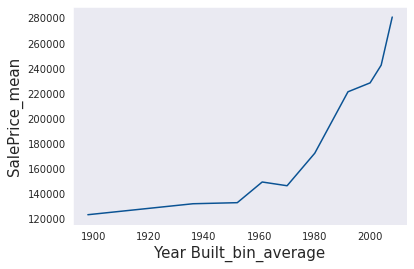

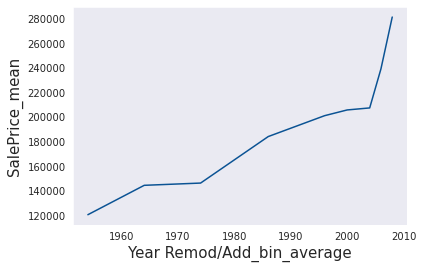

In [18]:

df[['Year Built', 'Year Remod/Add', 'SalePrice']].corr()
df[['Year Built', 'Year Remod/Add', 'SalePrice']].describe()

df_copy = df.copy()
df_copy = create_bins_cts_variable('Year Built', df_copy)
df_copy = create_bins_cts_variable('Year Remod/Add', df_copy)
df_copy.columns
df_copy.groupby(['Year Built_bins'])[['SalePrice']].agg('mean','count') 
df_copy.groupby(['Year Remod/Add_bins'])[['SalePrice']].agg('mean','count') 

numerical_to_categorical_and_plot('Year Built', 'SalePrice', df_copy)
numerical_to_categorical_and_plot('Year Remod/Add', 'SalePrice', df_copy)

**Investigating 'Yr Sold' and  'Mo Sold'**

- Mean prices have remained fairly constant by year and by month between 2006-2010
- Number of sales peaked in 2007 and have been goign down since
- Number of sales highest in summer
- not using these column sin model for now

,Yr Sold,Mo Sold,SalePrice
Yr Sold,1.000000,-0.147494,-0.015203
Mo Sold,-0.147494,1.000000,0.032735
SalePrice,-0.015203,0.032735,1.000000


,Yr Sold,Mo Sold,SalePrice
count,2051.000000,2051.000000,2051.000000
mean,2007.775719,6.219893,181469.701609
std,1.312014,2.744736,79258.659352
min,2006.000000,1.000000,12789.000000
25%,2007.000000,4.000000,129825.000000
50%,2008.000000,6.000000,162500.000000
75%,2009.000000,8.000000,214000.000000
max,2010.000000,12.000000,611657.000000


,SalePrice
Yr Sold,
2006,179471.609589
2007,185524.514056
2008,181750.372414
2009,182455.244395
2010,174180.059829


,SalePrice
Mo Sold,
1,195126.303797
2,177626.519231
3,174625.779762
4,163901.269231
5,180332.369650
6,182662.798295
7,188571.514851
8,186927.359281
9,188990.761468


SalePrice      
                          mean count
Yr Sold Mo Sold                     
2006    1        176741.666667    12
        2        182592.894737    19
        3        176811.371429    35
        4        144838.666667    36
        5        169035.096154    52
        6        176706.000000    65
        7        178504.975309    81
        8        201515.400000    30
        9        223841.032258    31
        10       165510.324324    37
        11       194654.571429    21
        12       193948.947368    19
2007    1        192601.173913    23
        2        170664.000000    26
        3        180383.658537    41
        4        162476.194444    36
        5        186866.796296    54
        6        188134.759036    83
        7        183400.944444    72
        8        196047.517857    56
        9        184522.153846    26
        10       191007.375000    32
        11       196677.354839    31
        12       187939.611111    18
2008    1        193462.666667    18
        2        155126.800000    20
        3        168420.038462    26
        4        163844.148936    47
        5        173439.425926    54
        6        194507.961538    78
        7        188316.056338    71
        8        199047.028571    35
        9        165427.045455    22
        10       170871.000000    14
        11       197643.769231    26
        12       181341.208333    24
2009    1        236103.300000    10
        2        208680.166667    18
        3        160687.903226    31
        4        187237.837838    37
        5        185570.227273    44
        6        179809.506849    73
        7        209312.773333    75
        8        157089.130435    46
        9        174131.666667    30
        10       185745.700000    40
        11       146696.000000    25
        12       165395.176471    17
2010    1        188805.625000    16
        2        176564.285714    21
        3        182650.200000    35
        4        161531.807692    52
        5        187433.358491    53
        6        167896.509434    53
        7        101125.000000     4

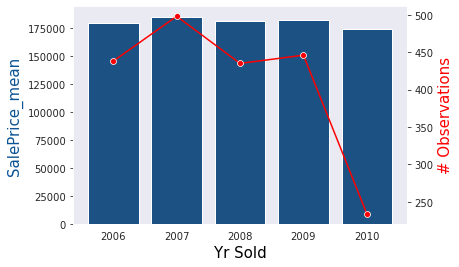

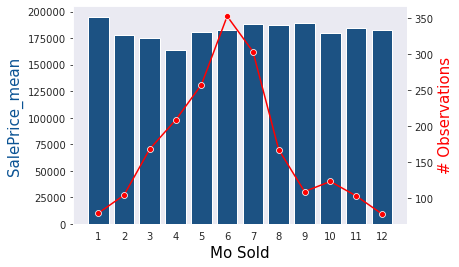

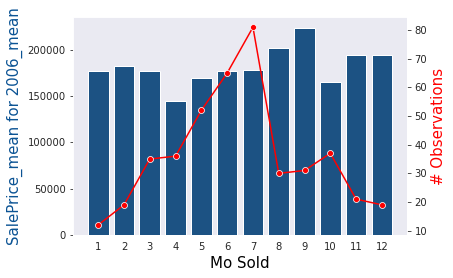

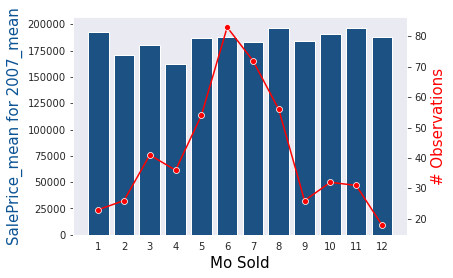

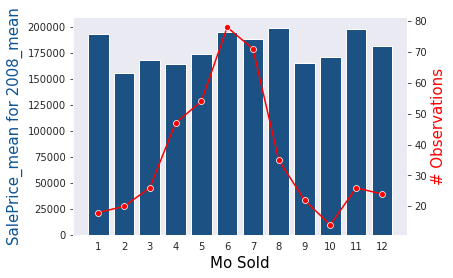

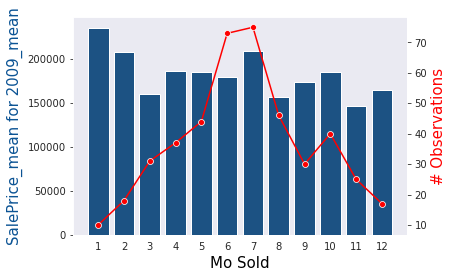

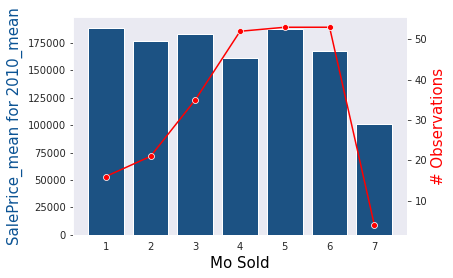

In [19]:
df[['Yr Sold', 'Mo Sold', 'SalePrice']].corr()
df[['Yr Sold', 'Mo Sold', 'SalePrice']].describe()

for col in ['Yr Sold', 'Mo Sold']:
    df_copy = df.copy()
    df_copy.groupby([col])[['SalePrice']].agg('mean','count') 
    plot_bar_line(col, 'SalePrice', df)

df_copy.groupby(['Yr Sold', 'Mo Sold'])[['SalePrice']].agg(['mean','count'])

for year in np.linspace(2006,2010,5):
    year = round(year)
    df_copy = df.copy()
    year_df = df_copy[df_copy['Yr Sold'] == year]
    year_df = year_df.rename(columns = {'SalePrice':f'SalePrice_mean for {year}'})
    plot_bar_line('Mo Sold', f'SalePrice_mean for {year}', year_df)



**Rest of the numerical columns**

- Create corresponding binary columns for 'Full Bath', 'Half Bath', 'Fireplaces'
    - Atleast_two_Full_bath (1 if Full Bath >= 2 else 0)
    - Atleast_one_Half_bath (1 if Half Bath >= 1 else 0)
    - Has_fireplace (1 if Fireplaces >=1 else 0) 
- Use 'TotRms AbvGrd' as-is even though it is non monotonic after 11, because there are very few observations greater than 11

- Not using 'Bedroom AbvGr' as it is not very linear or linearizable




SalePrice      
                    mean count
Full Bath                     
0          170226.000000     8
1          134870.961111   900
2          214600.614051  1096
3          304609.155556    45
4          269500.000000     2

SalePrice      
                    mean count
Half Bath                     
0          163751.821101  1308
1          213622.831724   725
2          173912.388889    18

SalePrice      
                        mean count
TotRms AbvGrd                     
2               39300.000000     1
3               97275.000000    12
4              127488.753425   146
5              143577.611794   407
6              164301.169179   597
7              200752.334737   475
8              216750.539474   228
9              262559.214286    98
10             285100.081633    49
11             333535.863636    22
12             265129.692308    13
13             205000.000000     1
14             200000.000000     1
15             183850.000000     1

SalePrice      
                     mean count
Fireplaces                     
0           142001.103000  1000
1           215478.776169   898
2           239893.589041   146
3           234808.333333     6
4           260000.000000     1

SalePrice      
                        mean count
Bedroom AbvGr                     
0              240791.800000     5
1              182388.920000    75
2              164656.601103   544
3              180627.309567  1108
4              215374.792453   265
5              203885.951220    41
6              164111.333333    12
8              200000.000000     1

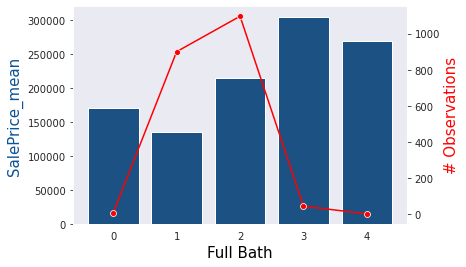

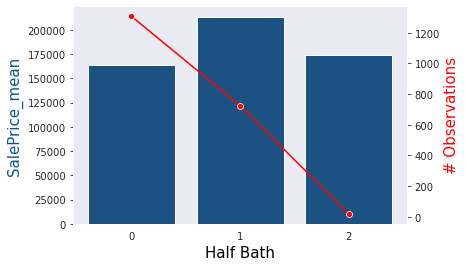

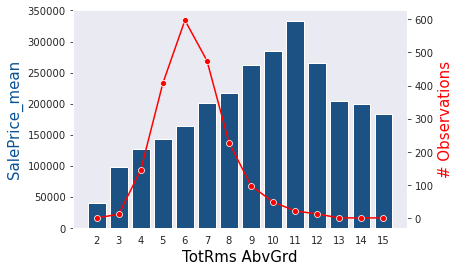

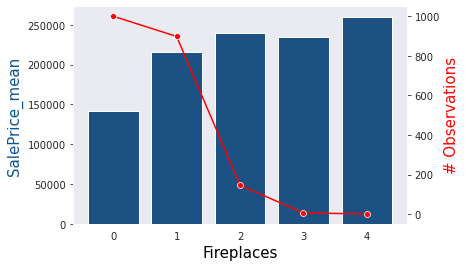

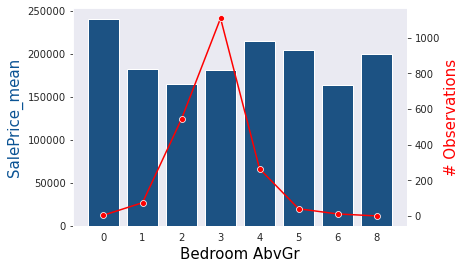

In [20]:
df.groupby(['Full Bath'])[['SalePrice']].agg({'mean','count'})
plot_bar_line('Full Bath', 'SalePrice', df)
df.groupby(['Half Bath'])[['SalePrice']].agg({'mean','count'})
plot_bar_line('Half Bath', 'SalePrice', df)

for col in ['TotRms AbvGrd','Fireplaces','Bedroom AbvGr']:
    df.groupby(col)[['SalePrice']].agg({'mean','count'})
    plot_bar_line(col, 'SalePrice', df)



**MS SubClass**

- A nominal column
- mean encoding the feature

SalePrice      
                      mean count
MS SubClass                     
60           239225.769036   394
120          211813.613636   132
75           204875.000000    16
20           189305.488312   770
80           169569.825581    86
85           154398.214286    28
70           153354.455556    90
150          148400.000000     1
90           139296.333333    75
160          138452.215909    88
50           137270.000000   198
190          124310.326087    46
40           119125.000000     4
45           116372.727273    11
180          109672.727273    11
30            94936.346535   101

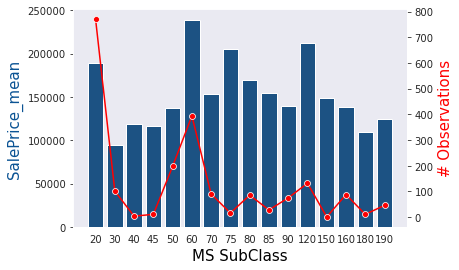

In [21]:
MS_Subclass_df = df.groupby('MS SubClass')[['SalePrice']].agg({'mean','count'})
MS_Subclass_df.sort_values(by = ('SalePrice',  'mean'), ascending = False)
plot_bar_line('MS SubClass', 'SalePrice', df)


**Outdoor features of the house**

- 'Open Porch SF','Wood Deck SF','Lot Area' can be usedafter capping at the 90% (133, 259, 14277) respectively but using them as-is for now 

- Not using 'Screen Porch','3Ssn Porch', 'Pool Area','Enclosed Porch' as these values are non zero for less than 10% of the homes


,Open Porch SF,Wood Deck SF,Lot Area,Screen Porch,3Ssn Porch,Pool Area,Enclosed Porch,SalePrice
Open Porch SF,1.000000,0.047630,0.140864,0.059027,-0.007336,0.073965,-0.077019,0.333476
Wood Deck SF,0.047630,1.000000,0.155623,-0.067770,-0.010851,0.128373,-0.114079,0.326490
Lot Area,0.140864,0.155623,1.000000,0.067714,0.019553,0.115102,0.014139,0.296566
Screen Porch,0.059027,-0.067770,0.067714,1.000000,-0.029574,0.033114,-0.069049,0.134581
3Ssn Porch,-0.007336,-0.010851,0.019553,-0.029574,1.000000,-0.006522,-0.032145,0.048732
Pool Area,0.073965,0.128373,0.115102,0.033114,-0.006522,1.000000,-0.015636,0.023106
Enclosed Porch,-0.077019,-0.114079,0.014139,-0.069049,-0.032145,-0.015636,1.000000,-0.135656
SalePrice,0.333476,0.326490,0.296566,0.134581,0.048732,0.023106,-0.135656,1.000000


count    2051.000000
mean       47.556802
std        66.747241
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%        27.000000
60%        40.000000
70%        58.000000
80%        86.000000
90%       133.000000
99%       289.500000
100%      547.000000
max       547.000000
Name: Open Porch SF, dtype: float64

SalePrice      
                             mean count
Open Porch SF_bins                     
(-0.001, 27.0]      146399.648256  1032
(27.0, 40.0]        202607.831731   208
(40.0, 58.0]        218521.649746   197
(58.0, 86.0]        223564.230392   204
(86.0, 133.0]       215895.325243   206
(133.0, 547.0]      224692.093137   204

count    2051.000000
mean       93.833740
std       128.549416
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%         0.000000
60%       100.000000
70%       144.000000
80%       192.000000
90%       259.000000
99%       518.000000
100%     1424.000000
max      1424.000000
Name: Wood Deck SF, dtype: float64

SalePrice      
                            mean count
Wood Deck SF_bins                     
(-0.001, 100.0]    159765.832123  1239
(100.0, 144.0]     194640.065421   214
(144.0, 192.0]     218233.161137   211
(192.0, 259.0]     229886.670330   182
(259.0, 1424.0]    218072.912195   205

count      2051.000000
mean      10065.208191
std        6742.488909
min        1300.000000
0%         1300.000000
1%         1680.000000
10%        5000.000000
20%        7006.000000
30%        7990.000000
40%        8730.000000
50%        9430.000000
60%       10140.000000
70%       10920.000000
80%       12205.000000
90%       14277.000000
99%       32894.000000
100%     159000.000000
max      159000.000000
Name: Lot Area, dtype: float64

SalePrice      
                              mean count
Lot Area_bins                           
(1299.999, 5000.0]   148520.786730   211
(5000.0, 7006.0]     137618.850000   200
(7006.0, 7990.0]     149570.146341   205
(7990.0, 8730.0]     155643.087805   205
(8730.0, 9430.0]     171498.000000   205
(9430.0, 10140.0]    176194.024038   208
(10140.0, 10920.0]   182624.069307   202
(10920.0, 12205.0]   205047.195122   205
(12205.0, 14277.0]   237976.492683   205
(14277.0, 159000.0]  249993.287805   205

count    2051.000000
mean       16.511458
std        57.374204
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%         0.000000
60%         0.000000
70%         0.000000
80%         0.000000
90%         0.000000
99%       265.500000
100%      490.000000
max       490.000000
Name: Screen Porch, dtype: float64

SalePrice      
                            mean count
Screen Porch_bins                     
(-0.001, 490.0]    181469.701609  2051

count    2051.000000
mean        2.591419
std        25.229615
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%         0.000000
60%         0.000000
70%         0.000000
80%         0.000000
90%         0.000000
99%       144.000000
100%      508.000000
max       508.000000
Name: 3Ssn Porch, dtype: float64

SalePrice      
                          mean count
3Ssn Porch_bins                     
(-0.001, 508.0]  181469.701609  2051

count    2051.000000
mean        2.397855
std        37.782570
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%         0.000000
60%         0.000000
70%         0.000000
80%         0.000000
90%         0.000000
99%         0.000000
100%      800.000000
max       800.000000
Name: Pool Area, dtype: float64

SalePrice      
                          mean count
Pool Area_bins                      
(-0.001, 800.0]  181469.701609  2051

count    2051.000000
mean       22.571916
std        59.845110
min         0.000000
0%          0.000000
1%          0.000000
10%         0.000000
20%         0.000000
30%         0.000000
40%         0.000000
50%         0.000000
60%         0.000000
70%         0.000000
80%         0.000000
90%       112.000000
99%       262.000000
100%      432.000000
max       432.000000
Name: Enclosed Porch, dtype: float64

SalePrice      
                              mean count
Enclosed Porch_bins                     
(-0.001, 112.0]      184089.243521  1852
(112.0, 432.0]       157090.849246   199

,SalePrice_mean,SalePrice_count,Open Porch SF_bin_average
Open Porch SF_bins,,,
"(-0.001, 27.0]",146399.648256,1032,13
"(27.0, 40.0]",202607.831731,208,34
"(40.0, 58.0]",218521.649746,197,49
"(58.0, 86.0]",223564.230392,204,72
"(86.0, 133.0]",215895.325243,206,110
"(133.0, 547.0]",224692.093137,204,340


,SalePrice_mean,SalePrice_count,Wood Deck SF_bin_average
Wood Deck SF_bins,,,
"(-0.001, 100.0]",159765.832123,1239,50
"(100.0, 144.0]",194640.065421,214,122
"(144.0, 192.0]",218233.161137,211,168
"(192.0, 259.0]",229886.670330,182,226
"(259.0, 1424.0]",218072.912195,205,842


,SalePrice_mean,SalePrice_count,Lot Area_bin_average
Lot Area_bins,,,
"(1299.999, 5000.0]",148520.786730,211,3150
"(5000.0, 7006.0]",137618.850000,200,6003
"(7006.0, 7990.0]",149570.146341,205,7498
"(7990.0, 8730.0]",155643.087805,205,8360
"(8730.0, 9430.0]",171498.000000,205,9080
"(9430.0, 10140.0]",176194.024038,208,9785
"(10140.0, 10920.0]",182624.069307,202,10530
"(10920.0, 12205.0]",205047.195122,205,11562
"(12205.0, 14277.0]",237976.492683,205,13241


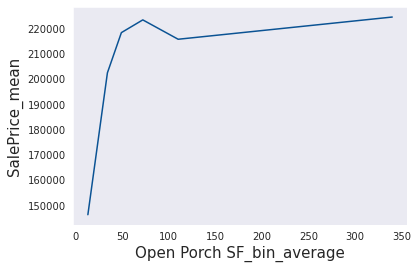

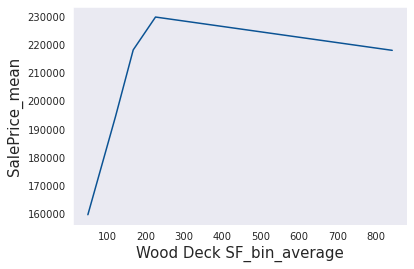

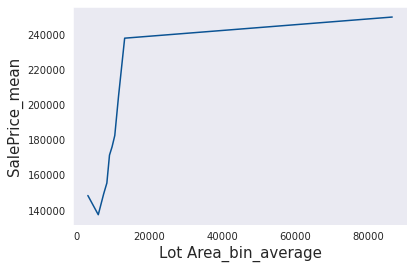

In [22]:
df[['Open Porch SF','Wood Deck SF','Lot Area', 'Screen Porch','3Ssn Porch', 'Pool Area','Enclosed Porch', 'SalePrice']].corr()

for continuous_variable in ['Open Porch SF','Wood Deck SF','Lot Area', 'Screen Porch','3Ssn Porch', 'Pool Area','Enclosed Porch']:
    df[continuous_variable].describe(np.append(np.linspace(0.0,1.0,11), [0.01,0.99]))
    df_copy = df.copy()
    df_copy[f'{continuous_variable}_bins'] = pd.qcut(df_copy[continuous_variable],10, duplicates = 'drop')
    df_copy.groupby(f'{continuous_variable}_bins').agg({target:['mean', 'count']})   
    
for col in ['Open Porch SF','Wood Deck SF','Lot Area']:
    df_copy = df.copy()
    numerical_to_categorical_and_plot(col, 'SalePrice', df_copy)


    


In [23]:
df.columns
corrs2 = df.corr()[['SalePrice']]
corrs2.sort_values(by = 'SalePrice', ascending = False)

Index(['Id', 'PID', 'MS SubClass', 'MS Zoning', 'Lot Area', 'Street',
       'Lot Shape', 'Land Contour', 'Utilities', 'Lot Config', 'Land Slope',
       'Neighborhood', 'Condition 1', 'Condition 2', 'Bldg Type',
       'House Style', 'Overall Qual', 'Overall Cond', 'Year Built',
       'Year Remod/Add', 'Roof Style', 'Roof Matl', 'Exterior 1st',
       'Exterior 2nd', 'Exter Qual', 'Exter Cond', 'Foundation', 'Heating',
       'Heating QC', 'Central Air', 'Electrical', '1st Flr SF', '2nd Flr SF',
       'Low Qual Fin SF', 'Gr Liv Area', 'Full Bath', 'Half Bath',
       'Bedroom AbvGr', 'Kitchen AbvGr', 'Kitchen Qual', 'TotRms AbvGrd',
       'Functional', 'Fireplaces', 'Garage Cars', 'Garage Area', 'Paved Drive',
       'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch',
       'Screen Porch', 'Pool Area', 'Misc Val', 'Mo Sold', 'Yr Sold',
       'Sale Type', 'SalePrice'],
      dtype='object')

,SalePrice
SalePrice,1.000000
Overall Qual,0.800207
Gr Liv Area,0.697038
Garage Area,0.649897
Garage Cars,0.647781
1st Flr SF,0.618486
Year Built,0.571849
Year Remod/Add,0.550370
Full Bath,0.537969
TotRms AbvGrd,0.504014


# Categorical Columns

In [24]:
ames_cat = ames_df.select_dtypes(object)
ames_cat.shape
ames_cat.columns
df_cat = df.select_dtypes(object)
df_cat.shape
df_cat.columns


(2051, 42)

Index(['MS Zoning', 'Street', 'Alley', 'Lot Shape', 'Land Contour',
       'Utilities', 'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1',
       'Condition 2', 'Bldg Type', 'House Style', 'Roof Style', 'Roof Matl',
       'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type', 'Exter Qual',
       'Exter Cond', 'Foundation', 'Bsmt Qual', 'Bsmt Cond', 'Bsmt Exposure',
       'BsmtFin Type 1', 'BsmtFin Type 2', 'Heating', 'Heating QC',
       'Central Air', 'Electrical', 'Kitchen Qual', 'Functional',
       'Fireplace Qu', 'Garage Type', 'Garage Finish', 'Garage Qual',
       'Garage Cond', 'Paved Drive', 'Pool QC', 'Fence', 'Misc Feature',
       'Sale Type'],
      dtype='object')

(2051, 27)

Index(['MS Zoning', 'Street', 'Lot Shape', 'Land Contour', 'Utilities',
       'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1',
       'Condition 2', 'Bldg Type', 'House Style', 'Roof Style', 'Roof Matl',
       'Exterior 1st', 'Exterior 2nd', 'Exter Qual', 'Exter Cond',
       'Foundation', 'Heating', 'Heating QC', 'Central Air', 'Electrical',
       'Kitchen Qual', 'Functional', 'Paved Drive', 'Sale Type'],
      dtype='object')

- Features to Binarize:
  - 'MS Zoning': indicator being in 'FV' or 'RL' (categories with mean SalePrice > overall mean SalePrice)
  - 'Lot Config': CulDSac indicator
  - 'Condition 1': indicator for 'Condition 1' = PosN or PosA or RRNn or Norm 
  (categories with mean price > overall mean SalePrice)
  - 'Bldg Type': Twnhse and 1Fam indicator
  - 'House Style': 2 or more stories indicator
  - 'Roof Style': Hip indicator
  - 'Exterior 1st' or 'Exterior 2nd' : indicator for mean sale price >= that for VinylSd
  - 'Exter Qual' : Ex/Gd indicator
  - 'Foundation':PConc indicator
  - 'Heating QC': Ex indicator
  - 'Sale Type': New indicator
  
- 'Kitchen Qual': Mean Encode  
  
- 'Neighborhood':
  - Mean Encode or
  - indicator for top 30% and bottom 30% neighborhoods
- 'Lot Shape' : dummify
- Not including in features: 'Street', 'Land Contour', 'Utilities','Land Slope', 'Condition 2', 'Roof Matl', 'Exter Cond', 'Heating', 'Central Air', 'Electrical', Functional', 'Paved Drive'


181469.70160897123

SalePrice      
                    mean count
MS Zoning                     
FV         218618.316832   101
RL         191235.164581  1598
RH         148859.571429    14
RM         129119.142405   316
C (all)     78010.894737    19
I (all)     57625.000000     1
A (agr)     47300.000000     2

SalePrice      
                 mean count
Street                     
Pave    181793.565558  2044
Grvl     86901.428571     7

SalePrice      
                    mean count
Lot Shape                     
IR2        233954.745455    55
IR1        211848.670520   692
IR3        193182.222222     9
Reg        162925.812355  1295

SalePrice      
                       mean count
Land Contour                     
HLS           262353.376471    85
Low           199313.116279    43
Lvl           178998.564840  1843
Bnk           142868.775000    80

SalePrice      
                    mean count
Utilities                     
AllPub     181551.602245  2049
NoSeWa     137500.000000     1
NoSewr      57625.000000     1

SalePrice      
                     mean count
Lot Config                     
CulDSac     230744.358779   131
FR3         198600.000000     9
Corner      180629.591954   348
Inside      177537.014637  1503
FR2         174703.600000    60

SalePrice      
                     mean count
Land Slope                     
Mod         204639.465909    88
Sev         194598.000000    10
Gtl         180358.476703  1953

SalePrice      
                       mean count
Neighborhood                     
StoneBr       329675.736842    38
NridgHt       322831.352459   122
NoRidge       316294.125000    48
GrnHill       280000.000000     2
Veenker       253570.588235    17
Timber        241051.354167    48
Somerst       227183.900000   130
ClearCr       217490.074074    27
Crawfor       205901.211268    71
CollgCr       202497.216667   180
Blmngtn       200417.681818    22
NWAmes        194619.022989    87
Gilbert       189228.387931   116
Greens        188666.666667     3
SawyerW       187760.160920    87
Mitchel       167656.707317    82
NAmes         145905.816129   310
Blueste       144566.666667     6
NPkVill       140476.470588    17
Sawyer        137181.909910   111
Landmrk       137000.000000     1
SWISU         134758.875000    32
Edwards       130493.468531   143
BrkSide       127022.697368    76
OldTown       125276.300613   163
BrDale        103371.052632    19
IDOTRR        101103.188406    69
MeadowV       100231.250000    24

SalePrice      
                      mean count
Condition 1                     
PosN         254794.296296    27
PosA         254733.333333    12
RRNn         198208.333333     6
Norm         185007.310130  1767
RRAn         172604.777778    36
Feedr        143223.605505   109
RRAe         139685.714286    21
RRNe         129616.666667     3
Artery       128765.000000    70

SalePrice      
                      mean count
Condition 2                     
PosN         395666.666667     3
PosA         390666.666667     3
RRAe         190000.000000     1
Norm         181382.075556  2025
RRAn         136905.000000     1
Feedr        129181.818182    11
Artery       119050.000000     5
RRNn          96750.000000     2

SalePrice      
                    mean count
Bldg Type                     
TwnhsE     198312.372671   161
1Fam       185275.685882  1700
Duplex     139296.333333    75
Twnhs      133100.000000    69
2fmCon     123179.891304    46

SalePrice      
                      mean count
House Style                     
2.5Fin       243666.666667     6
2Story       206408.963211   598
2.5Unf       191785.714286    14
1Story       179809.194523  1059
SLvl         166248.989362    94
SFoyer       149343.920000    50
1.5Fin       136480.091743   218
1.5Unf       112466.666667    12

SalePrice      
                     mean count
Roof Style                     
Hip         224366.654912   397
Shed        208666.666667     3
Flat        191613.076923    13
Gable       171264.253243  1619
Mansard     152642.857143     7
Gambrel     138208.333333    12

SalePrice      
                    mean count
Roof Matl                     
WdShngl    339400.000000     5
WdShake    264250.000000     4
Membran    241500.000000     1
Tar&Grv    187948.933333    15
CompShg    180849.197037  2025
ClyTile    160000.000000     1

SalePrice      
                       mean count
Exterior 1st                     
ImStucc       262000.000000     1
Stone         258500.000000     2
CemntBd       243429.088889    90
VinylSd       218174.082873   724
BrkFace       193055.093750    64
Plywood       170511.453947   152
HdBoard       159582.473333   300
WdShing       155616.822222    45
MetalSd       154402.048338   331
Wd Sdng       142940.887681   276
Stucco        139712.962963    27
BrkComm       131000.000000     3
AsbShng       103183.333333    33
CBlock         93250.000000     2
AsphShn        82375.000000     1

SalePrice      
                       mean count
Exterior 2nd                     
CmentBd       239540.200000    90
ImStucc       227472.727273    11
VinylSd       217798.685160   721
BrkFace       187992.647059    34
Plywood       166485.713514   185
HdBoard       160836.880000   275
MetalSd       155978.635802   324
Wd Shng       154244.444444    63
Stucco        147725.333333    30
Wd Sdng       145654.396947   262
Stone         145420.666667     6
Brk Cmn       139958.823529    17
AsphShn       132125.000000     3
AsbShng       107108.928571    28
CBlock         92000.000000     2

SalePrice      
                     mean count
Exter Qual                     
Ex          374460.308642    81
Gd          230802.484935   697
TA          143270.978348  1247
Fa           89801.192308    26

SalePrice      
                     mean count
Exter Cond                     
Ex          236263.857143     7
TA          185258.202475  1778
Gd          167623.023256   215
Fa          102507.693878    49
Po           44800.000000     2

SalePrice      
                     mean count
Foundation                     
PConc       227676.483801   926
Wood        173750.000000     2
CBlock      148415.530707   863
Stone       143235.200000     5
BrkTil      129050.190045   221
Slab        108810.676471    34

SalePrice      
                 mean count
Heating                    
GasA     182422.47671  2018
GasW     151275.00000    20
OthW     125750.00000     2
Wall      77150.00000     6
Grav      65180.00000     5

SalePrice      
                     mean count
Heating QC                     
Ex          216027.607512  1065
Gd          160174.009404   319
TA          138986.705193   597
Fa          117123.641791    67
Po           69033.333333     3

<ipython-input-5-81a35c49b576>:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax1 = plt.subplots()


SalePrice      
                      mean count
Central Air                     
Y            187441.503665  1910
N            100575.078014   141

SalePrice      
                     mean count
Electrical                     
SBrkr       187770.382227  1868
FuseA       122565.157143   140
FuseF       103678.914286    35
FuseP        83485.714286     7
Mix          67000.000000     1

SalePrice      
                       mean count
Kitchen Qual                     
Ex            336424.463576   151
Gd            211629.451613   806
TA            139501.607450  1047
Fa            101334.957447    47

SalePrice      
                     mean count
Functional                     
Typ         183954.749347  1915
Maj1        163106.166667    12
Min1        154429.761905    42
Min2        150424.571429    42
Mod         148108.724138    29
Sev          95750.000000     2
Maj2         87157.714286     7
Sal          31550.000000     2

SalePrice      
                      mean count
Paved Drive                     
Y            188792.163890  1861
P            129824.461538    39
N            104562.827815   151

SalePrice      
                    mean count
Sale Type                     
New        279021.056250   160
Con        241807.500000     4
ConLI      207992.857143     7
CWD        186635.000000    10
WD         174912.251544  1781
COD        133574.523810    63
ConLD      129091.352941    17
Oth        127497.750000     4
ConLw      124600.000000     5

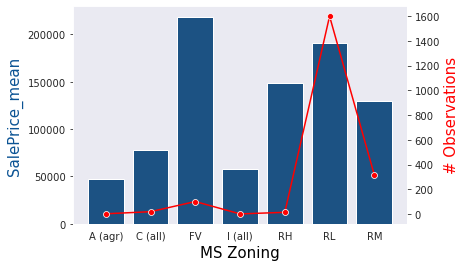

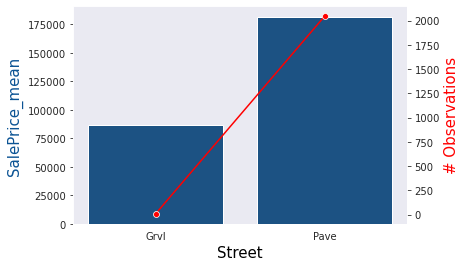

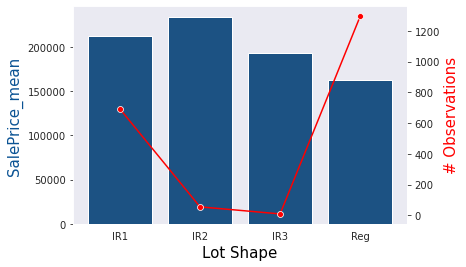

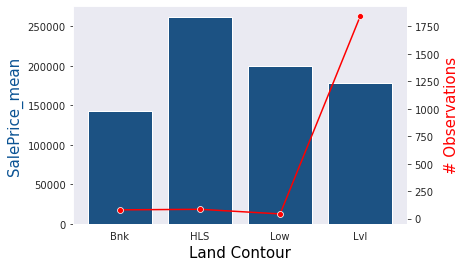

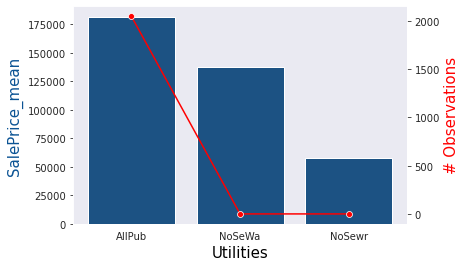

...

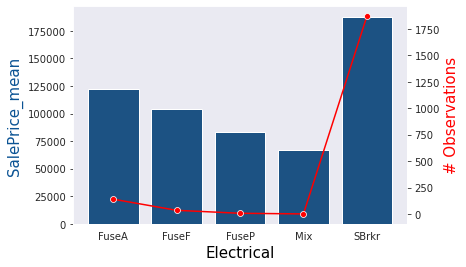

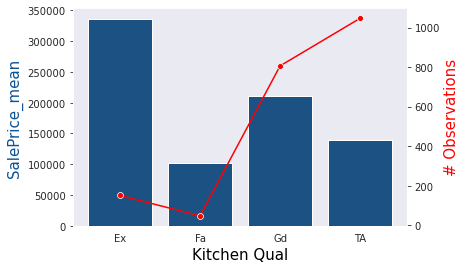

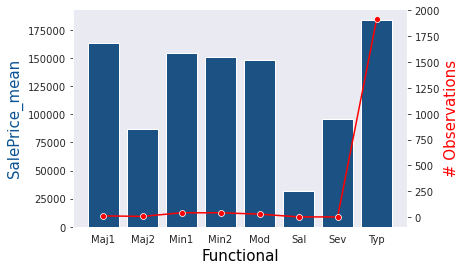

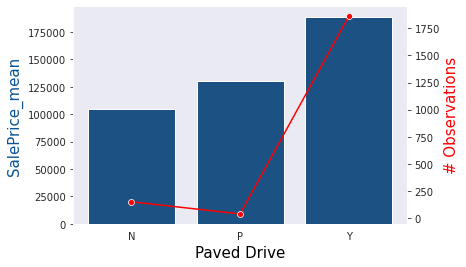

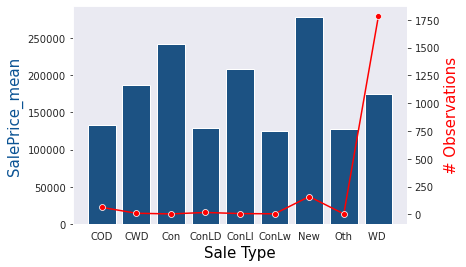

In [25]:
df['SalePrice'].mean()
for col in df_cat.columns:
    df.groupby(col)[['SalePrice']].agg({'mean','count'}).sort_values(by = ('SalePrice', 'mean'), ascending = False)
    plot_bar_line(col, 'SalePrice', df)

In [26]:

#numerical features
#choosing 13/39(28 without any nulls) columns based on the analysis above
num_columns_to_mean_encode = ['Overall Qual' , 'MS SubClass']
num_columns_to_binarize = ['Full Bath' , 'Half Bath', 'Fireplaces']
num_continuous_variables = ['Gr Liv Area', 'Year Built','Year Remod/Add', 'Garage Area'] #to be used as-is
num_columns_that_may_be_capped = ['TotRms AbvGrd','Open Porch SF','Wood Deck SF','Lot Area'] 
# will be used as-is as only 10% are above the capping values decided earlier

#categorical features
#choosing 14/42 columns (27 with no nulls) based on analysis above
cat_cols_to_binarize = ['MS Zoning', 
       'Lot Config', 'Condition 1',
       'Bldg Type', 'House Style', 'Roof Style', 
       'Exterior 2nd', 'Exter Qual', 
       'Foundation', 'Heating QC',
       'Sale Type']
cat_columns_to_mean_encode = ['Kitchen Qual','Neighborhood']
cat_columns_to_dummify = ['Lot Shape']



In [27]:
def mean_encode_discrete_col(col, target, df):
    '''
    inputs: df with columns col and target 
    replaces col with a mean encoded version of col
    (x in col with target mean for all rows with col = x)
    returns a copy of the df with an additional column named 'mean_encoded_col'
    '''
    df_copy = df.copy()
    means_df = df_copy.groupby([col])[[target]].mean()
    df_copy[f'mean_encoded_{col}']=df_copy[col].map(lambda x : means_df.loc[x,target])
    test_df = df_copy.groupby([col,f'mean_encoded_{col}'])[[target]].mean().reset_index()
    assert(sum(test_df[target] - test_df[f'mean_encoded_{col}']) == 0)
    df[col]=df_copy[f'mean_encoded_{col}']
    return df_copy

def binarize_discrete_col(col, target, df, num):
    X = df.copy()
    X[col] = X[col].map(lambda x : 1 if x >= num else 0)
        



In [28]:
#drop columns that are not being used

feature_columns =(
                 num_columns_to_mean_encode
                 +num_columns_to_binarize
                 +num_continuous_variables
                 +num_columns_that_may_be_capped
                 +cat_cols_to_binarize
                 +cat_columns_to_mean_encode
                 +cat_columns_to_dummify
                 
) 
columns_to_drop = [col for col in df.columns if col not in feature_columns + ['SalePrice']]
featurized_df = df[feature_columns].copy()

featurized_df.columns

columns_to_drop

Index(['Overall Qual', 'MS SubClass', 'Full Bath', 'Half Bath', 'Fireplaces',
       'Gr Liv Area', 'Year Built', 'Year Remod/Add', 'Garage Area',
       'TotRms AbvGrd', 'Open Porch SF', 'Wood Deck SF', 'Lot Area',
       'MS Zoning', 'Lot Config', 'Condition 1', 'Bldg Type', 'House Style',
       'Roof Style', 'Exterior 2nd', 'Exter Qual', 'Foundation', 'Heating QC',
       'Sale Type', 'Kitchen Qual', 'Neighborhood', 'Lot Shape'],
      dtype='object')

['Id',
 'PID',
 'Street',
 'Land Contour',
 'Utilities',
 'Land Slope',
 'Condition 2',
 'Overall Cond',
 'Roof Matl',
 'Exterior 1st',
 'Exter Cond',
 'Heating',
 'Central Air',
 'Electrical',
 '1st Flr SF',
 '2nd Flr SF',
 'Low Qual Fin SF',
 'Bedroom AbvGr',
 'Kitchen AbvGr',
 'Functional',
 'Garage Cars',
 'Paved Drive',
 'Enclosed Porch',
 '3Ssn Porch',
 'Screen Porch',
 'Pool Area',
 'Misc Val',
 'Mo Sold',
 'Yr Sold']

In [29]:
feature_columns+['SalePrice']

['Overall Qual',
 'MS SubClass',
 'Full Bath',
 'Half Bath',
 'Fireplaces',
 'Gr Liv Area',
 'Year Built',
 'Year Remod/Add',
 'Garage Area',
 'TotRms AbvGrd',
 'Open Porch SF',
 'Wood Deck SF',
 'Lot Area',
 'MS Zoning',
 'Lot Config',
 'Condition 1',
 'Bldg Type',
 'House Style',
 'Roof Style',
 'Exterior 2nd',
 'Exter Qual',
 'Foundation',
 'Heating QC',
 'Sale Type',
 'Kitchen Qual',
 'Neighborhood',
 'Lot Shape',
 'SalePrice']

In [30]:
Mean_maps = {col : df.groupby([col])[['SalePrice']].mean() 
             for col in ['Overall Qual' , 'MS SubClass', 'Kitchen Qual','Neighborhood']}
Mean_maps['Kitchen Qual'].loc['Po',:] =  Mean_maps['Kitchen Qual'].loc['Fa','SalePrice']

# pd.DataFrame([['Po',Mean_maps['Kitchen Qual'].loc['Fa','SalePrice']]])
# Mean_maps['Kitchen Qual'].append(pd.DataFrame([['Po',]]))
# X must have the target variable column(SalesPrice) for mean encoding to work
def treat_features(X , Mean_maps):
    
    for col in num_columns_to_mean_encode + cat_columns_to_mean_encode:
        X[col]=X[col].map(lambda x : Mean_maps[col].loc[x,'SalePrice'])        
    X['Full Bath'] = X['Full Bath'].map(lambda x : 1 if x >= 2 else 0) #indicator for Full Bath >= 2
    X['Half Bath'] = X['Half Bath'].map(lambda x : 1 if x >= 1 else 0) #indicator for Half Bath >= 1
    X['Fireplaces'] = X['Fireplaces'].map(lambda x : 1 if x >= 1 else 0) #indicator for  Fireplaces >= 1
    X['MS Zoning'] = X['MS Zoning'].map(lambda x : 1 if ((x == 'FV') or (x=='RL')) else 0)
    X['Lot Config'] = X['Lot Config'].map(lambda x : 1 if x=='CulDSac' else 0)
    X['Condition 1'] = X['Condition 1'].map(lambda x : 1 if ((x=='PosN') or (x=='PosA') or 
                                                             (x=='RRNn') or (x=='Norm')) else 0)
    X['Bldg Type'] = X['Bldg Type'].map(lambda x : 1 if ((x == 'TwnhsE') or (x=='1Fam')) else 0)
    X['House Style'] = X['House Style'].map(lambda x : 1 if ((x=='2.5Fin') or (x=='2.5Unf') or 
                                                             (x=='2Story')) else 0)
    X['Roof Style'] = X['Roof Style'].map(lambda x : 1 if x=='Hip' else 0)
    X['Exterior 2nd'] = X['Exterior 2nd'].map(lambda x : 1 if x in ['CmentBd','ImStucc','VinylSd'] else 0)
    X['Exter Qual'] = X['Exter Qual'].map(lambda x : 1 if x in ['Ex','Gd'] else 0)
    X['Foundation'] = X['Foundation'].map(lambda x : 1 if x in ['PConc'] else 0)
    X['Heating QC'] = X['Heating QC'].map(lambda x : 1 if x in ['Ex'] else 0)
    X['Sale Type'] = X['Sale Type'].map(lambda x : 1 if x in ['New'] else 0)
    X = pd.get_dummies(X, columns=['Lot Shape'], drop_first=True)
    return X




In [31]:
X = df[feature_columns+['SalePrice']].copy()  

for col in num_columns_to_mean_encode + cat_columns_to_mean_encode:
    mean_encode_discrete_col(col, 'SalePrice', X)
X['Full Bath'] = X['Full Bath'].map(lambda x : 1 if x >= 2 else 0) #indicator for Full Bath >= 2
X['Half Bath'] = X['Half Bath'].map(lambda x : 1 if x >= 1 else 0) #indicator for Half Bath >= 1
X['Fireplaces'] = X['Fireplaces'].map(lambda x : 1 if x >= 1 else 0) #indicator for  Fireplaces >= 1
X['MS Zoning'] = X['MS Zoning'].map(lambda x : 1 if ((x == 'FV') or (x=='RL')) else 0)
X['Lot Config'] = X['Lot Config'].map(lambda x : 1 if x=='CulDSac' else 0)
X['Condition 1'] = X['Condition 1'].map(lambda x : 1 if ((x=='PosN') or (x=='PosA') or 
                                                         (x=='RRNn') or (x=='Norm')) else 0)
X['Bldg Type'] = X['Bldg Type'].map(lambda x : 1 if ((x == 'TwnhsE') or (x=='1Fam')) else 0)
X['House Style'] = X['House Style'].map(lambda x : 1 if ((x=='2.5Fin') or (x=='2.5Unf') or 
                                                         (x=='2Story')) else 0)
X['Roof Style'] = X['Roof Style'].map(lambda x : 1 if x=='Hip' else 0)
X['Exterior 2nd'] = X['Exterior 2nd'].map(lambda x : 1 if x in ['CmentBd','ImStucc','VinylSd'] else 0)
X['Exter Qual'] = X['Exter Qual'].map(lambda x : 1 if x in ['Ex','Gd'] else 0)
X['Foundation'] = X['Foundation'].map(lambda x : 1 if x in ['PConc'] else 0)
X['Heating QC'] = X['Heating QC'].map(lambda x : 1 if x in ['Ex'] else 0)
X['Sale Type'] = X['Sale Type'].map(lambda x : 1 if x in ['New'] else 0)
X = pd.get_dummies(X, columns=['Lot Shape'], drop_first=True)

y = X['SalePrice']
X = X.drop(columns = ['SalePrice'])


,Overall Qual,MS SubClass,Full Bath,Half Bath,Fireplaces,Gr Liv Area,Year Built,Year Remod/Add,Garage Area,TotRms AbvGrd,Open Porch SF,Wood Deck SF,Lot Area,MS Zoning,Lot Config,Condition 1,Bldg Type,House Style,Roof Style,Exterior 2nd,Exter Qual,Foundation,Heating QC,Sale Type,Kitchen Qual,Neighborhood,Lot Shape,SalePrice,mean_encoded_Overall Qual
0,6,60,2,1,0,1479,1976,2005,475.0,6,44,0,13517,RL,CulDSac,RRAe,1Fam,2Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,Sawyer,IR1,130500,162891.102767
1,7,60,2,1,1,2122,1996,1997,559.0,8,74,0,11492,RL,CulDSac,Norm,1Fam,2Story,Gable,VinylSd,Gd,PConc,Ex,WD,Gd,SawyerW,IR1,220000,203430.285383
2,5,20,1,0,0,1057,1953,2007,246.0,5,52,0,7922,RL,Inside,Norm,1Fam,1Story,Gable,VinylSd,TA,CBlock,TA,WD,Gd,NAmes,Reg,109000,134963.644760
3,5,60,2,1,0,1444,2006,2007,400.0,7,0,100,9802,RL,Inside,Norm,1Fam,2Story,Gable,VinylSd,TA,PConc,Gd,WD,TA,Timber,Reg,174000,134963.644760
4,6,50,2,0,0,1445,1900,1993,484.0,6,59,0,14235,RL,Inside,Norm,1Fam,1.5Fin,Gable,Plywood,TA,PConc,TA,WD,TA,SawyerW,IR1,138500,162891.102767
5,6,20,2,1,1,1888,1966,2002,578.0,6,0,0,16492,RL,Corner,PosA,1Fam,1Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,NAmes,IR1,190000,162891.102767
6,6,180,2,0,0,1072,2005,2006,525.0,5,44,0,3675,RM,Inside,Norm,TwnhsE,SFoyer,Gable,VinylSd,TA,PConc,Gd,New,TA,Edwards,Reg,140000,162891.102767
7,5,20,1,0,0,1188,1959,1959,531.0,6,0,0,12160,RL,Inside,Norm,1Fam,1Story,Hip,Plywood,TA,CBlock,Fa,COD,TA,NAmes,IR1,142000,134963.644760
8,5,20,1,0,0,924,1952,1952,420.0,6,324,0,15783,RL,Inside,Artery,1Fam,1Story,Gable,Wd Sdng,TA,CBlock,TA,WD,TA,OldTown,Reg,112500,134963.644760
9,5,60,1,2,2,2080,1969,1969,504.0,9,0,335,11606,RL,Inside,Norm,1Fam,2Story,Gable,Plywood,TA,PConc,TA,WD,Fa,NAmes,IR1,135000,134963.644760


,Overall Qual,MS SubClass,Full Bath,Half Bath,Fireplaces,Gr Liv Area,Year Built,Year Remod/Add,Garage Area,TotRms AbvGrd,Open Porch SF,Wood Deck SF,Lot Area,MS Zoning,Lot Config,Condition 1,Bldg Type,House Style,Roof Style,Exterior 2nd,Exter Qual,Foundation,Heating QC,Sale Type,Kitchen Qual,Neighborhood,Lot Shape,SalePrice,mean_encoded_MS SubClass
0,162891.102767,60,2,1,0,1479,1976,2005,475.0,6,44,0,13517,RL,CulDSac,RRAe,1Fam,2Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,Sawyer,IR1,130500,239225.769036
1,203430.285383,60,2,1,1,2122,1996,1997,559.0,8,74,0,11492,RL,CulDSac,Norm,1Fam,2Story,Gable,VinylSd,Gd,PConc,Ex,WD,Gd,SawyerW,IR1,220000,239225.769036
2,134963.644760,20,1,0,0,1057,1953,2007,246.0,5,52,0,7922,RL,Inside,Norm,1Fam,1Story,Gable,VinylSd,TA,CBlock,TA,WD,Gd,NAmes,Reg,109000,189305.488312
3,134963.644760,60,2,1,0,1444,2006,2007,400.0,7,0,100,9802,RL,Inside,Norm,1Fam,2Story,Gable,VinylSd,TA,PConc,Gd,WD,TA,Timber,Reg,174000,239225.769036
4,162891.102767,50,2,0,0,1445,1900,1993,484.0,6,59,0,14235,RL,Inside,Norm,1Fam,1.5Fin,Gable,Plywood,TA,PConc,TA,WD,TA,SawyerW,IR1,138500,137270.000000
5,162891.102767,20,2,1,1,1888,1966,2002,578.0,6,0,0,16492,RL,Corner,PosA,1Fam,1Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,NAmes,IR1,190000,189305.488312
6,162891.102767,180,2,0,0,1072,2005,2006,525.0,5,44,0,3675,RM,Inside,Norm,TwnhsE,SFoyer,Gable,VinylSd,TA,PConc,Gd,New,TA,Edwards,Reg,140000,109672.727273
7,134963.644760,20,1,0,0,1188,1959,1959,531.0,6,0,0,12160,RL,Inside,Norm,1Fam,1Story,Hip,Plywood,TA,CBlock,Fa,COD,TA,NAmes,IR1,142000,189305.488312
8,134963.644760,20,1,0,0,924,1952,1952,420.0,6,324,0,15783,RL,Inside,Artery,1Fam,1Story,Gable,Wd Sdng,TA,CBlock,TA,WD,TA,OldTown,Reg,112500,189305.488312
9,134963.644760,60,1,2,2,2080,1969,1969,504.0,9,0,335,11606,RL,Inside,Norm,1Fam,2Story,Gable,Plywood,TA,PConc,TA,WD,Fa,NAmes,IR1,135000,239225.769036


,Overall Qual,MS SubClass,Full Bath,Half Bath,Fireplaces,Gr Liv Area,Year Built,Year Remod/Add,Garage Area,TotRms AbvGrd,Open Porch SF,Wood Deck SF,Lot Area,MS Zoning,Lot Config,Condition 1,Bldg Type,House Style,Roof Style,Exterior 2nd,Exter Qual,Foundation,Heating QC,Sale Type,Kitchen Qual,Neighborhood,Lot Shape,SalePrice,mean_encoded_Kitchen Qual
0,162891.102767,239225.769036,2,1,0,1479,1976,2005,475.0,6,44,0,13517,RL,CulDSac,RRAe,1Fam,2Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,Sawyer,IR1,130500,211629.451613
1,203430.285383,239225.769036,2,1,1,2122,1996,1997,559.0,8,74,0,11492,RL,CulDSac,Norm,1Fam,2Story,Gable,VinylSd,Gd,PConc,Ex,WD,Gd,SawyerW,IR1,220000,211629.451613
2,134963.644760,189305.488312,1,0,0,1057,1953,2007,246.0,5,52,0,7922,RL,Inside,Norm,1Fam,1Story,Gable,VinylSd,TA,CBlock,TA,WD,Gd,NAmes,Reg,109000,211629.451613
3,134963.644760,239225.769036,2,1,0,1444,2006,2007,400.0,7,0,100,9802,RL,Inside,Norm,1Fam,2Story,Gable,VinylSd,TA,PConc,Gd,WD,TA,Timber,Reg,174000,139501.607450
4,162891.102767,137270.000000,2,0,0,1445,1900,1993,484.0,6,59,0,14235,RL,Inside,Norm,1Fam,1.5Fin,Gable,Plywood,TA,PConc,TA,WD,TA,SawyerW,IR1,138500,139501.607450
5,162891.102767,189305.488312,2,1,1,1888,1966,2002,578.0,6,0,0,16492,RL,Corner,PosA,1Fam,1Story,Gable,Plywood,Gd,CBlock,Ex,WD,Gd,NAmes,IR1,190000,211629.451613
6,162891.102767,109672.727273,2,0,0,1072,2005,2006,525.0,5,44,0,3675,RM,Inside,Norm,TwnhsE,SFoyer,Gable,VinylSd,TA,PConc,Gd,New,TA,Edwards,Reg,140000,139501.607450
7,134963.644760,189305.488312,1,0,0,1188,1959,1959,531.0,6,0,0,12160,RL,Inside,Norm,1Fam,1Story,Hip,Plywood,TA,CBlock,Fa,COD,TA,NAmes,IR1,142000,139501.607450
8,134963.644760,189305.488312,1,0,0,924,1952,1952,420.0,6,324,0,15783,RL,Inside,Artery,1Fam,1Story,Gable,Wd Sdng,TA,CBlock,TA,WD,TA,OldTown,Reg,112500,139501.607450
9,134963.644760,239225.769036,1,2,2,2080,1969,1969,504.0,9,0,335,11606,RL,Inside,Norm,1Fam,2Story,Gable,Plywood,TA,PConc,TA,WD,Fa,NAmes,IR1,135000,101334.957447


,Overall Qual,MS SubClass,Full Bath,Half Bath,Fireplaces,Gr Liv Area,Year Built,Year Remod/Add,Garage Area,TotRms AbvGrd,Open Porch SF,Wood Deck SF,Lot Area,MS Zoning,Lot Config,Condition 1,Bldg Type,House Style,Roof Style,Exterior 2nd,Exter Qual,Foundation,Heating QC,Sale Type,Kitchen Qual,Neighborhood,Lot Shape,SalePrice,mean_encoded_Neighborhood
0,162891.102767,239225.769036,2,1,0,1479,1976,2005,475.0,6,44,0,13517,RL,CulDSac,RRAe,1Fam,2Story,Gable,Plywood,Gd,CBlock,Ex,WD,211629.451613,Sawyer,IR1,130500,137181.909910
1,203430.285383,239225.769036,2,1,1,2122,1996,1997,559.0,8,74,0,11492,RL,CulDSac,Norm,1Fam,2Story,Gable,VinylSd,Gd,PConc,Ex,WD,211629.451613,SawyerW,IR1,220000,187760.160920
2,134963.644760,189305.488312,1,0,0,1057,1953,2007,246.0,5,52,0,7922,RL,Inside,Norm,1Fam,1Story,Gable,VinylSd,TA,CBlock,TA,WD,211629.451613,NAmes,Reg,109000,145905.816129
3,134963.644760,239225.769036,2,1,0,1444,2006,2007,400.0,7,0,100,9802,RL,Inside,Norm,1Fam,2Story,Gable,VinylSd,TA,PConc,Gd,WD,139501.607450,Timber,Reg,174000,241051.354167
4,162891.102767,137270.000000,2,0,0,1445,1900,1993,484.0,6,59,0,14235,RL,Inside,Norm,1Fam,1.5Fin,Gable,Plywood,TA,PConc,TA,WD,139501.607450,SawyerW,IR1,138500,187760.160920
5,162891.102767,189305.488312,2,1,1,1888,1966,2002,578.0,6,0,0,16492,RL,Corner,PosA,1Fam,1Story,Gable,Plywood,Gd,CBlock,Ex,WD,211629.451613,NAmes,IR1,190000,145905.816129
6,162891.102767,109672.727273,2,0,0,1072,2005,2006,525.0,5,44,0,3675,RM,Inside,Norm,TwnhsE,SFoyer,Gable,VinylSd,TA,PConc,Gd,New,139501.607450,Edwards,Reg,140000,130493.468531
7,134963.644760,189305.488312,1,0,0,1188,1959,1959,531.0,6,0,0,12160,RL,Inside,Norm,1Fam,1Story,Hip,Plywood,TA,CBlock,Fa,COD,139501.607450,NAmes,IR1,142000,145905.816129
8,134963.644760,189305.488312,1,0,0,924,1952,1952,420.0,6,324,0,15783,RL,Inside,Artery,1Fam,1Story,Gable,Wd Sdng,TA,CBlock,TA,WD,139501.607450,OldTown,Reg,112500,125276.300613
9,134963.644760,239225.769036,1,2,2,2080,1969,1969,504.0,9,0,335,11606,RL,Inside,Norm,1Fam,2Story,Gable,Plywood,TA,PConc,TA,WD,101334.957447,NAmes,IR1,135000,145905.816129


# Feature Selction

Using L1 regularization


In [87]:
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())
    

In [83]:
X3 = X.copy()
y3 = y.copy()
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3,test_size=0.35,random_state=2)
sc = StandardScaler()
Z_train = sc.fit_transform(X3_train)
Z_test = sc.transform(X3_test)
Z_train.shape
Z_test.shape
X3.shape
X_kaggle = treat_features(X_unknown[feature_columns], Mean_maps)
Z_kaggle = sc.fit_transform(X_kaggle)

(1333, 29)

(718, 29)

(2051, 29)

<ipython-input-30-6ce8f7836541>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[col]=X[col].map(lambda x : Mean_maps[col].loc[x,'SalePrice'])
<ipython-input-30-6ce8f7836541>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['Full Bath'] = X['Full Bath'].map(lambda x : 1 if x >= 2 else 0) #indicator for Full Bath >= 2
<ipython-input-30-6ce8f7836541>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

Se

In [89]:
l_alphas = np.logspace(-3, 1, 100)
lasso_cv = LassoCV(alphas=l_alphas, cv=5, max_iter=50_000, n_jobs=-1)
lasso_cv.fit(Z_L1_train, y3_train);
print(f"LASSO Training R-Squared: {lasso_cv.score(Z_train, y3_train)} ")
print(f"LASSO Testing R-Squared: {lasso_cv.score(Z_test, y3_test)} ")

print(f"LASSO Training R-Squared: {lasso_cv.score(Z_train, y3_train)} ")
print(f"LASSO Testing R-Squared: {lasso_cv.score(Z_test, y3_test)} ")

print(f"LASSO Training RMSE: {rmse(lasso_cv.predict(Z_train),y3_train)} ")
print(f"LASSO Testing RMSE: {rmse(lasso_cv.predict(Z_test),y3_test)} ")

lasso_cv.score
pd.DataFrame(list(zip(feature_columns, lasso_cv.coef_)), 
             columns=['Feature', 'Coefficient']).sort_values(by='Coefficient', ascending = False)
lasso_preds = lasso_cv.predict(Z_kaggle)
lasso_preds.shape
submission2 = pd.DataFrame({'Id':test['Id'],'SalePrice':lasso_preds})
submission2.to_csv('../datasets/submission2.csv',index = False)

LassoCV(alphas=array([1.00000000e-03, 1.09749877e-03, 1.20450354e-03, 1.32194115e-03,
       1.45082878e-03, 1.59228279e-03, 1.74752840e-03, 1.91791026e-03,
       2.10490414e-03, 2.31012970e-03, 2.53536449e-03, 2.78255940e-03,
       3.05385551e-03, 3.35160265e-03, 3.67837977e-03, 4.03701726e-03,
       4.43062146e-03, 4.86260158e-03, 5.33669923e-03, 5.85702082e-03,
       6.42807312e-03, 7.05480231e-0...
       1.17681195e+00, 1.29154967e+00, 1.41747416e+00, 1.55567614e+00,
       1.70735265e+00, 1.87381742e+00, 2.05651231e+00, 2.25701972e+00,
       2.47707636e+00, 2.71858824e+00, 2.98364724e+00, 3.27454916e+00,
       3.59381366e+00, 3.94420606e+00, 4.32876128e+00, 4.75081016e+00,
       5.21400829e+00, 5.72236766e+00, 6.28029144e+00, 6.89261210e+00,
       7.56463328e+00, 8.30217568e+00, 9.11162756e+00, 1.00000000e+01]),
        cv=5, max_iter=50000, n_jobs=-1)

LASSO Training R-Squared: 0.8834176559660684 
LASSO Testing R-Squared: 0.7804597595548246 
LASSO Training R-Squared: 0.8834176559660684 
LASSO Testing R-Squared: 0.7804597595548246 
LASSO Training RMSE: 27811.74663684492 
LASSO Testing RMSE: 35103.12168695852 


<bound method RegressorMixin.score of LassoCV(alphas=array([1.00000000e-03, 1.09749877e-03, 1.20450354e-03, 1.32194115e-03,
       1.45082878e-03, 1.59228279e-03, 1.74752840e-03, 1.91791026e-03,
       2.10490414e-03, 2.31012970e-03, 2.53536449e-03, 2.78255940e-03,
       3.05385551e-03, 3.35160265e-03, 3.67837977e-03, 4.03701726e-03,
       4.43062146e-03, 4.86260158e-03, 5.33669923e-03, 5.85702082e-03,
       6.42807312e-03, 7.05480231e-0...
       1.17681195e+00, 1.29154967e+00, 1.41747416e+00, 1.55567614e+00,
       1.70735265e+00, 1.87381742e+00, 2.05651231e+00, 2.25701972e+00,
       2.47707636e+00, 2.71858824e+00, 2.98364724e+00, 3.27454916e+00,
       3.59381366e+00, 3.94420606e+00, 4.32876128e+00, 4.75081016e+00,
       5.21400829e+00, 5.72236766e+00, 6.28029144e+00, 6.89261210e+00,
       7.56463328e+00, 8.30217568e+00, 9.11162756e+00, 1.00000000e+01]),
        cv=5, max_iter=50000, n_jobs=-1)>

,Feature,Coefficient
5,Gr Liv Area,33028.898706
0,Overall Qual,26794.052471
25,Neighborhood,10121.634799
24,Kitchen Qual,9478.239514
6,Year Built,6988.925852
8,Garage Area,5471.979233
23,Sale Type,4862.967665
12,Lot Area,4063.277590
11,Wood Deck SF,3601.191833
7,Year Remod/Add,3431.561075


(878,)

In [82]:
# elastic net
# Set up a list of alphas to check.
e_alphas = np.linspace(0.01, 1, 100)

# Set up our l1 ratio. (What does this do?)
enet_ratio = 0.7

# Instantiate model.
enet_model = ElasticNetCV(alphas=e_alphas, l1_ratio=enet_ratio, cv=5, max_iter=3000, n_jobs=-1)

# Fit model using optimal alpha.
enet_model.fit(Z_train, y3_train)

# Generate predictions.


# Evaluate model.
print(enet_model.score(Z_train, y3_train))
print(enet_model.score(Z_test, y3_test))

pd.DataFrame(list(zip(feature_columns, enet_model.coef_)), 
             columns=['Feature', 'Coefficient']).sort_values(by='Coefficient', ascending = False)

ElasticNetCV(alphas=array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 , 0.11,
       0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64, 0.65, 0.66,
       0.67, 0.68, 0.69, 0.7 , 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77,
       0.78, 0.79, 0.8 , 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88,
       0.89, 0.9 , 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
       1.  ]),
             cv=5, l1_ratio=0.7, max_iter=3000, n_jobs=-1)

0.8833774370128198
0.7829608311010464


,Feature,Coefficient
5,Gr Liv Area,32000.423265
0,Overall Qual,26498.246632
25,Neighborhood,10193.461008
24,Kitchen Qual,9566.851131
6,Year Built,6753.984012
8,Garage Area,5592.384185
23,Sale Type,4850.101314
12,Lot Area,4115.906123
11,Wood Deck SF,3664.835690
7,Year Remod/Add,3380.274684


# Fitting the model and Cross Validation

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.3,random_state=2)
linreg = LinearRegression()
cross_val_score(estimator=linreg, X=X_train, y=y_train, cv=7)

array([0.87605507, 0.89539097, 0.8561359 , 0.84273699, 0.87178529,
       0.90523773, 0.86623609])

In [33]:
cross_val_score(estimator=linreg, X=X_train, y=y_train, cv=7)
cross_val_score(estimator=linreg, X=X_test, y=y_test, cv=7)


array([0.87605507, 0.89539097, 0.8561359 , 0.84273699, 0.87178529,
       0.90523773, 0.86623609])

array([0.84704854, 0.88270565, 0.84446015, 0.81176361, 0.72144122,
       0.49017516, 0.8697669 ])

In [34]:
columns_with_nulls
test

Index(['Lot Frontage', 'Alley', 'Mas Vnr Type', 'Mas Vnr Area', 'Bsmt Qual',
       'Bsmt Cond', 'Bsmt Exposure', 'BsmtFin Type 1', 'BsmtFin SF 1',
       'BsmtFin Type 2', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF',
       'Bsmt Full Bath', 'Bsmt Half Bath', 'Fireplace Qu', 'Garage Type',
       'Garage Yr Blt', 'Garage Finish', 'Garage Qual', 'Garage Cond',
       'Pool QC', 'Fence', 'Misc Feature'],
      dtype='object')

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type
0,2658,902301120,190,RM,69.0,9142,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,2fmCon,2Story,6,8,1910,1950,Gable,CompShg,AsbShng,AsbShng,None,0.0,TA,Fa,Stone,Fa,TA,No,Unf,0,Unf,0,1020,1020,GasA,Gd,N,FuseP,908,1020,0,1928,0,0,2,0,4,2,Fa,9,Typ,0,NaN,Detchd,1910.0,Unf,1,440,Po,Po,Y,0,60,112,0,0,0,NaN,NaN,NaN,0,4,2006,WD
1,2718,905108090,90,RL,NaN,9662,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,Duplex,1Story,5,4,1977,1977,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,Unf,0,Unf,0,1967,1967,GasA,TA,Y,SBrkr,1967,0,0,1967,0,0,2,0,6,2,TA,10,Typ,0,NaN,Attchd,1977.0,Fin,2,580,TA,TA,Y,170,0,0,0,0,0,NaN,NaN,NaN,0,8,2006,WD
2,2414,528218130,60,RL,58.0,17104,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,Gd,Av,GLQ,554,Unf,0,100,654,GasA,Ex,Y,SBrkr,664,832,0,1496,1,0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,2006.0,RFn,2,426,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,9,2006,New
3,1989,902207150,30,RM,60.0,8520,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1Story,5,6,1923,2006,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,Gd,TA,CBlock,TA,TA,No,Unf,0,Unf,0,968,968,GasA,TA,Y,SBrkr,968,0,0,968,0,0,1,0,2,1,TA,5,Typ,0,NaN,Detchd,1935.0,Unf,2,480,Fa,TA,N,0,0,184,0,0,0,NaN,NaN,NaN,0,7,2007,WD
4,625,535105100,20,RL,NaN,9500,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,5,1963,1963,Gable,CompShg,Plywood,Plywood,BrkFace,247.0,TA,TA,CBlock,Gd,TA,No,BLQ,609,Unf,0,785,1394,GasA,Gd,Y,SBrkr,1394,0,0,1394,1,0,1,1,3,1,TA,6,Typ,2,Gd,Attchd,1963.0,RFn,2,514,TA,TA,Y,0,76,0,0,185,0,NaN,NaN,NaN,0,7,2009,WD
5,333,923228370,160,RM,21.0,1890,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,TwnhsE,2Story,4,6,1972,1972,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,294,Unf,0,252,546,GasA,TA,Y,SBrkr,546,546,0,1092,0,0,1,1,3,1,TA,5,Typ,0,NaN,Attchd,1972.0,Unf,1,286,TA,TA,Y,0,0,64,0,0,0,NaN,NaN,NaN,0,6,2010,WD
6,1327,902427150,20,RM,52.0,8516,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1Story,4,6,1958,2006,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0,Unf,0,869,869,GasA,TA,Y,SBrkr,1093,0,0,1093,0,0,1,0,2,1,TA,5,Typ,0,NaN,Detchd,1959.0,Unf,1,308,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,5,2008,WD
7,858,907202130,20,RL,NaN,9286,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Mod,CollgCr,Norm,Norm,1Fam,1Story,5,7,1977,1989,Gable,CompShg,HdBoard,Plywood,None,0.0,TA,TA,CBlock,Gd,Gd,Av,ALQ,196,Unf,0,1072,1268,GasA,TA,Y,SBrkr,1268,0,0,1268,0,0,1,1,3,1,Gd,5,Typ,0,NaN,Detchd,1978.0,Unf,1,252,TA,TA,Y,173,0,0,0,0,0,NaN,NaN,NaN,0,10,2009,WD
8,95,533208090,160,FV,39.0,3515,Pave,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,TwnhsE,2Story,7,5,2004,2004,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,No,Unf,0,Unf,0,840,840,GasA,Ex,Y,SBrkr,840,840,0,1680,0,0,2,1,2,1,Gd,3,Typ,0,NaN,Attchd,2004.0,RFn,2,588,TA,TA,Y,0,111,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD
9,1568,914476010,20,RL,75.0,10125,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,6,6,1977,1977,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,TA,TA,N

In [35]:
Mean_maps = {col : df.groupby([col])[['SalePrice']].mean() 
             for col in ['Overall Qual' , 'MS SubClass', 'Kitchen Qual','Neighborhood']}
Mean_maps['Kitchen Qual'].loc['Po',:] =  Mean_maps['Kitchen Qual'].loc['Fa','SalePrice']
X_unknown = test.copy()
model1 = LinearRegression()
model1.fit(X, y)
preds1 = model1.predict(treat_features(X_unknown[feature_columns],Mean_maps))


LinearRegression()

<ipython-input-30-6ce8f7836541>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[col]=X[col].map(lambda x : Mean_maps[col].loc[x,'SalePrice'])
<ipython-input-30-6ce8f7836541>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['Full Bath'] = X['Full Bath'].map(lambda x : 1 if x >= 2 else 0) #indicator for Full Bath >= 2
<ipython-input-30-6ce8f7836541>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

Se

In [36]:
len(preds1)
test['Id']
submission1 = pd.DataFrame({'Id':test['Id'],'SalePrice':preds1})
submission1.to_csv('../datasets/submission1.csv',index = False)

878

0      2658
1      2718
2      2414
3      1989
4       625
5       333
6      1327
7       858
8        95
9      1568
10     2482
11     1364
12     2584
13      818
14     2673
15     2089
16     1297
17      790
18     2616
19      720
20      222
21      557
22     1148
23     2766
24      534
25     1452
26      630
27     2648
28      125
29     1904
30     1670
31      756
32      717
33     1032
34      852
35     1731
36     2639
37     2071
38     1267
39     1851
40      567
41     2439
42     1898
43      647
44     2256
45      979
46     1444
47     2485
48      157
49       88
50     2003
51      186
52     1425
53     2695
54      738
55      395
56     1353
57     1878
58      390
59     1456
60     1103
61     1387
62     2070
63     1199
64     2479
65      501
66     2362
67     1718
68     2188
69     1483
70     2557
71      437
72     2224
73     1628
74      397
75      587
76      971
77     2611
78     1887
79     2399
80     2148
81      304
82     1997
83  

In [69]:
y_pred = model1.predict(X)
np.sqrt(mean_squared_error(y, y_pred))

29595.000983655227

In [38]:
lr1 = LinearRegression()
lr1.fit(X_train,y_train)
y_test_pred = lr1.predict(X_test)
y_train_pred = lr1.predict(X_train)
np.sqrt(mean_squared_error(y_train, y_train_pred))
np.sqrt(mean_squared_error(y_test, y_test_pred))
lr1.score(X_train,y_train)
lr1.score(X_test,y_test)

pd.DataFrame(list(zip(feature_columns, lr1.coef_)), 
             columns=['Feature', 'Coefficient']).sort_values(by='Coefficient', ascending = False)

LinearRegression()

27683.104613633295

36410.76754351168

0.88218429635161

0.7694979474285993

,Feature,Coefficient
23,Sale Type,17872.512641
18,Roof Style,8001.934132
15,Condition 1,7483.483348
4,Fireplaces,5905.347265
26,Lot Shape,4754.855289
22,Heating QC,3443.110470
16,Bldg Type,3218.827554
14,Lot Config,3056.700151
13,MS Zoning,2599.069825
21,Foundation,1047.002901


In [72]:
# Dropping House Style, Full Bath as negative coefficients here do not make sense

Mean_maps = {col : df.groupby([col])[['SalePrice']].mean() 
             for col in ['Overall Qual' , 'MS SubClass', 'Kitchen Qual','Neighborhood']}
Mean_maps['Kitchen Qual'].loc['Po',:] =  Mean_maps['Kitchen Qual'].loc['Fa','SalePrice']
X_no_housestyle_Fullbath = treat_features(df[feature_columns+['SalePrice']].copy(), Mean_maps).drop(columns = ['House Style', 'Full Bath' ])
y2 = X_no_housestyle_Fullbath.loc[:,'SalePrice']
X2 = X_no_housestyle_Fullbath.drop(columns = ['SalePrice'])

X2.columns
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2,test_size=0.35,random_state=2)
model2 = LinearRegression()
cross_val_score(estimator=model2, X=X2_train, y=y2_train, cv=7)



#X_unknown = test.copy()
#model2 = LinearRegression()
model2.fit(X2_train, y2_train)
model2.score(X2_train, y2_train)
model2.score(X2_test, y2_test)

np.sqrt(mean_squared_error(y2_train,  model2.predict(X2_train)))
np.sqrt(mean_squared_error(y2_test,  model2.predict(X2_test)))


pd.DataFrame(list(zip([col for col in feature_columns if col not in ['House Style','Full Bath'] ], model2.coef_)), 
             columns=['Feature', 'Coefficient']).sort_values(by='Coefficient', ascending = False)

#preds2 = model2.predict(treat_features(X_unknown[feature_columns].drop(columns = ['House Style', 'Full Bath' ]),Mean_maps))

Index(['Overall Qual', 'MS SubClass', 'Half Bath', 'Fireplaces', 'Gr Liv Area',
       'Year Built', 'Year Remod/Add', 'Garage Area', 'TotRms AbvGrd',
       'Open Porch SF', 'Wood Deck SF', 'Lot Area', 'MS Zoning', 'Lot Config',
       'Condition 1', 'Bldg Type', 'Roof Style', 'Exterior 2nd', 'Exter Qual',
       'Foundation', 'Heating QC', 'Sale Type', 'Kitchen Qual', 'Neighborhood',
       'Lot Shape_IR2', 'Lot Shape_IR3', 'Lot Shape_Reg'],
      dtype='object')

array([0.89286148, 0.85260106, 0.82988935, 0.88184283, 0.85662822,
       0.89688089, 0.87289978])

LinearRegression()

0.8770298539265745

0.7879398961552266

28563.519404852505

34499.92545544838

,Feature,Coefficient
21,Sale Type,17847.491381
16,Roof Style,11176.793228
15,Bldg Type,10802.507962
24,Lot Shape,6373.692848
14,Condition 1,6302.058207
3,Fireplaces,6017.154459
12,MS Zoning,5217.885095
20,Heating QC,3367.788261
13,Lot Config,3170.356234
17,Exterior 2nd,413.177281
